In [1]:
import numpy as np
import torch
from sbi import utils as utils
from sbi.inference.base import infer
import matplotlib.pyplot as plt
from data_read import read_obs, read_indiv_obs
from analysis_utils import violin_plots, welch_ttest,glassdelta_effect_size, mse, marked_dist_plot
import sklearn
import scipy.io
from scipy.stats import ttest_ind
import pickle
import copy
import pandas as pd
import seaborn as sns
from sbi import analysis as analysis
import pandas as pd
import configparser
from model import Model

train = False

In [16]:
all_labels = ['Aud Delay',
          'Somat Delay',
          'Fb Noise Var (log10)',
          'Fb Noise Ratio (Aud:Som)',
          'Controller Gain']

def simulator_no_noise(parameter_set):
    config = configparser.ConfigParser()
    config.read('pitch_pert_configs.ini')
    override_params(config,parameter_set)
    model = Model(config)
    y_output,errors = model.run()
    pitch_output = y_output[:,0,0]
    pitch_output[pitch_output < 50] = 50
    pitch_baseline = np.mean(pitch_output[0:50])
    pitch_output_cents = 1200 * np.log2(pitch_output/pitch_baseline)
    return pitch_output_cents

def override_params(config,parameter_set):
    config['Observer']['aud_fdbk_delay'] = str(parameter_set[0].item())
    config['Observer']['somat_fdbk_delay'] = str(parameter_set[1].item())
    config['Vocal_Tract']['aud_noise_covariance'] = str(10**parameter_set[2].item())
    config['Vocal_Tract']['somat_noise_covariance'] = str(10**parameter_set[2].item() / parameter_set[3].item())
    config['Controller']['controller_gain'] = str(parameter_set[4].item())

def simulator(parameter_set):
    training_noise_scale = 7
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

def compare(posterior, obs_list, n_samples,prior_min,prior_max,labels,fwer=0.05,fit_stde=False,name=None,xlabel=False,title='',figlabel=''):
    data_list=[]
    for observation in obs_list:
        np.random.seed(10)
        torch.manual_seed(10)
        samples = posterior.sample((n_samples,), x=observation.get('data'))
        log_probability = posterior.log_prob(samples, x=observation.get('data'))
        max_likelihood = samples[torch.argmax(log_probability)]
        print(max_likelihood)
        topk_likelihood = samples[torch.topk(log_probability,1000).indices]
        marked_dist_plot(samples, prior_min, prior_max, labels, max_likelihood=max_likelihood, actual_params=None, name=observation.get('name'))
        data = {'name': observation.get('name'),'color': observation.get('color'),'taxis':observation.get('taxis'),'samples':samples, 
                'max_likelihood': max_likelihood, 'topk_likelihood': topk_likelihood}
        data_list.append(data)
    sig_list = welch_ttest(data_list,fwer,len(labels))
    glass_delta_list = glassdelta_effect_size(data_list,len(labels),n_samples)
    plot_actual_data(obs_list)
    inferred_list = plot_actual_inferred_data(obs_list,data_list,name=name,xlabel=xlabel,ylabel=True,ylim=None,title=title,figlabel=figlabel)
    diff_list = np.ndarray((2,))
    diff_list[0] = mse(obs_list[0].get('data'),inferred_list[0,:])
    diff_list[1] = mse(obs_list[1].get('data'),inferred_list[1,:])
    print("MSE: " + str(diff_list))
    violin_plots(data_list,sig_list,glass_delta_list,prior_min,prior_max,labels,name)
    return data_list, diff_list
    
def plot_actual_data(obs_list,ax=None,xlabel=False,ylabel=False,ylim=[-5,45],legend=False,show_pert=False,alpha=0.5):
    if ax is None:
        fig, ax = plt.subplots()
    if show_pert:
        ax.axvspan(0,0.4,alpha=0.08,color='gray')
        ax.annotate('Perturbation',(0.01,40),fontsize=14,color='gray')
    for i, obs in enumerate(obs_list):
        ax.plot(obs.get('taxis'),obs.get('data'),label=obs.get('name'),linewidth=5,linestyle=':',color=obs.get('color'),alpha=alpha)
        ax.plot(obs.get('taxis'),obs.get('data')+obs.get('stde'),linestyle=':',linewidth=2,color=obs.get('color'),alpha=alpha)
        ax.plot(obs.get('taxis'),obs.get('data')-obs.get('stde'),linestyle=':',linewidth=2,color=obs.get('color'),alpha=alpha)
        #plt.fill_between(obs.get('taxis'),
        #             obs.get('data')+obs.get('stde'),
        #             obs.get('data')-obs.get('stde'),
        #             linewidth=5,color='#A3A3A3')
        if xlabel:
            ax.set_xlabel('Time (s)',fontsize=18)
            ax.tick_params(axis='x',which='major',labelsize=16)
        else: ax.set_xticks([])
        if ylabel:
            ax.set_ylabel('Pitch (cents)',fontsize=18)
            ax.tick_params(axis='y',which='major',labelsize=16)
        else: ax.set_yticks([])
        if ylim is not None:
            ax.set_ylim(ylim)
        if legend:
            ax.annotate(obs.get('name'), (0.65, 40-4*i), fontsize=18, color=obs.get('color'))
                     
def plot_actual_inferred_data(obs_list,data_list,ax=None,name=None,xlabel=False,ylabel=False,ylim=[-5,45],obs_to_plot=None,color=None,legend=True,title='',figlabel=''):
    ntrials = 1000
    inferred_list = np.ndarray((len(obs_list),len(obs_list[0].get('data'))))
    #plt.figure(figsize=(5,4))
    if ax is None:
        fig, ax = plt.subplots()
    ax.text(-0.6,20,title,ha='center',va='center',rotation=90,size=24,fontweight='bold')
    ax.text(-0.7,50,figlabel,ha='center',va='center',size=45)
    if len(obs_list) < 5:
        plot_actual_data(obs_list,ax,xlabel,ylabel,ylim,legend=True)
        for i, data in enumerate(data_list):
            #topk_likelihood = data.get('topk_likelihood')
            #ntrials = topk_likelihood.shape[0]
            if color is None: plot_color = data.get('color')
            else: plot_color = color
            taxis = obs_list[0].get('taxis')
            inferred_all = np.ndarray((ntrials,len(taxis)))
            for j in range(ntrials):
                #params = topk_likelihood[j,:]
                inferred_all[j,:] = simulator_no_noise(data.get('max_likelihood'))
                #inferred_all[j,:] = simulator_no_noise(params)
            inferred = np.median(inferred_all,axis=0)
            stde = np.std(inferred_all,axis=0) / np.sqrt(ntrials)
            inferred_list[i,:] = inferred
            if obs_to_plot is None or i in obs_to_plot:
                ax.plot(taxis,inferred,label=data.get('name')+' inferred',linewidth=5,color=plot_color)
                ax.plot(taxis,inferred-stde, linewidth=2,color=plot_color)
                ax.plot(taxis,inferred+stde, linewidth=2, color=plot_color)
    else: 
        for x in range(len(obs_list)):
            plot_actual_inferred_data([obs_list[x]],[data_list[x]],name=name,xlabel=xlabel)
    return inferred_list

def run_sbi(filename,nreps,prior_min_all,prior_max_all,all_labels,train=True,ablate=None):
    mse_sub = np.ndarray([2,nreps])
    labels = copy.deepcopy(all_labels)
    prior_min = copy.deepcopy(prior_min_all)
    prior_max = copy.deepcopy(prior_max_all)
    if ablate is not None:
        ablated_label = labels.pop(ablate)
        prior_min.pop(ablate)
        prior_max.pop(ablate)
        title = 'Fixed ' + ablated_label.split('(')[0]
        figlabel = ['A','B','C','D','E'][ablate]
    else: 
        title = ''
        figlabel = ''
    inferred_control_values_all = np.ndarray([len(labels),2,n_reps])
    for i, seed in enumerate([100,200,300,400,500,600,700,800,900,1000]):
        if train:
            prior = utils.torchutils.BoxUniform(low=torch.as_tensor(prior_min), high=torch.as_tensor(prior_max))
            np.random.seed(seed)
            torch.manual_seed(seed)
            posterior = infer(simulator,prior, method='SNPE', num_simulations=n_simulations)
            posterior_save = {'prior_min':prior_min,'prior_max':prior_max,'posterior':posterior,'seed':seed}
            with open('posterior/'+ filename + '_seed' + str(seed) + '.pkl', "wb") as handle:
                pickle.dump(posterior_save,handle)
        np.random.seed(seed)
        torch.manual_seed(seed)
        with open('posterior/'+ filename + '_seed' + str(seed) + '.pkl', 'rb') as handle:
            posterior_dict = pickle.load(handle)
        posterior_new = posterior_dict.get('posterior')
        prior_min = posterior_dict.get('prior_min')
        prior_max = posterior_dict.get('prior_max')
        data_list,mse_sub[:,i] = compare(posterior_new,list(observation_dict.get('CA').values()),n_samples,prior_min,prior_max,labels,fit_stde=False,name='CA',xlabel=True,title=title,figlabel=figlabel)
        inferred_control_values_all[:,0,i] = data_list[0].get('max_likelihood')
        inferred_control_values_all[:,1,i] = data_list[1].get('max_likelihood')
    return data_list,inferred_control_values_all,mse_sub 

In [5]:
observation_dict = {}
    
observation_dict['CA'] = {'Controls': read_obs('pitch_pert_data/CA_Data/','CA','jh','control',"#C7221F"), 
                          'Patients': read_obs('pitch_pert_data/CA_Data/','CA','jh','patient',"#456990")}

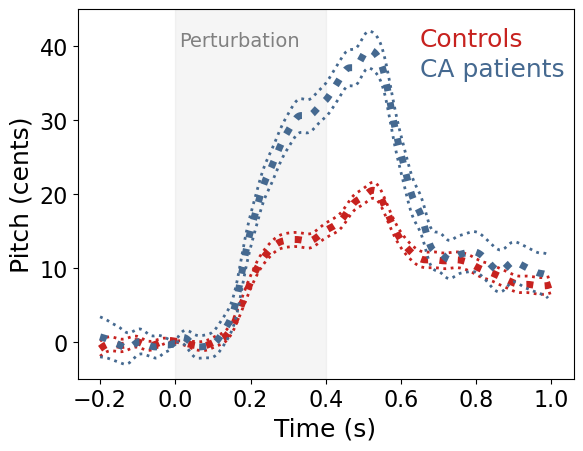

In [10]:
plot_actual_data(observation_dict.get('CA').values(),xlabel='Time (s)',ylabel='Pitch (cents)',legend=True,show_pert=True,alpha=1)

In [17]:
n_simulations = 100000
n_samples = 10000
n_reps = 10
mse_vals = np.ndarray([4,2,n_reps])

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.3775,  20.8519,  -8.9592,   1.9905,   1.9831])


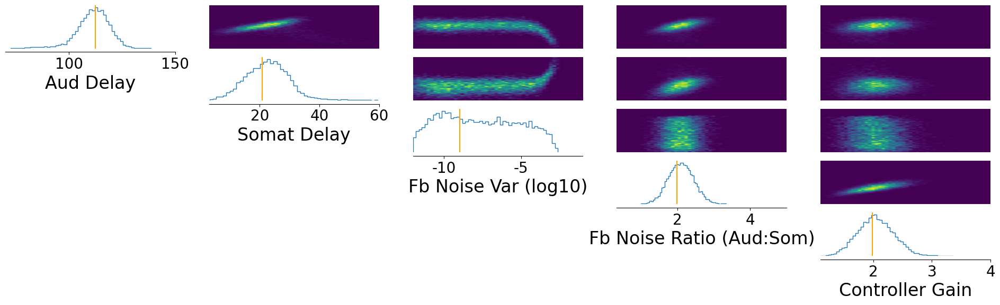

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.4298, 12.6618, -3.4976,  1.1568,  3.1427])


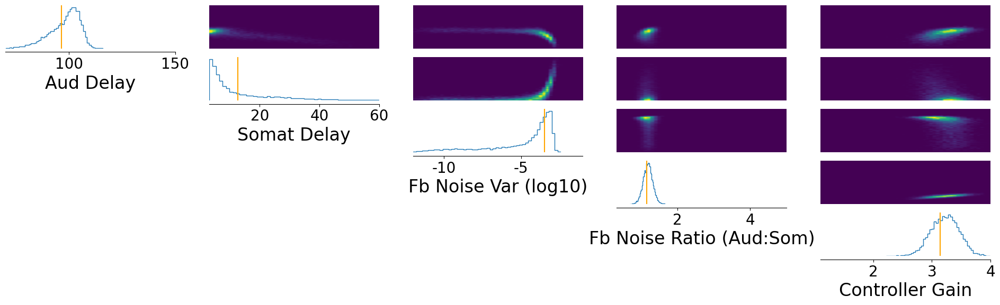

MSE: [0.39433918 4.36576474]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([105.7431,  15.6289,  -6.8791,   1.7849,   1.8897])


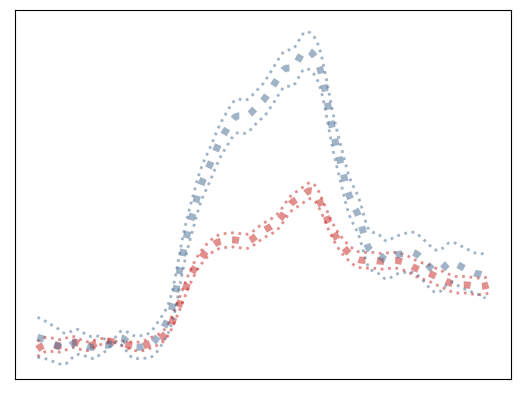

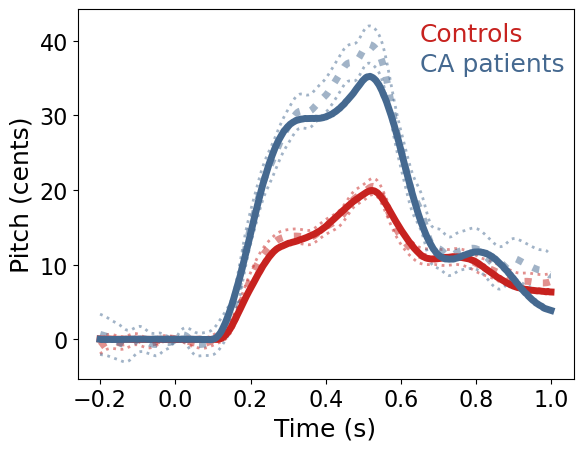

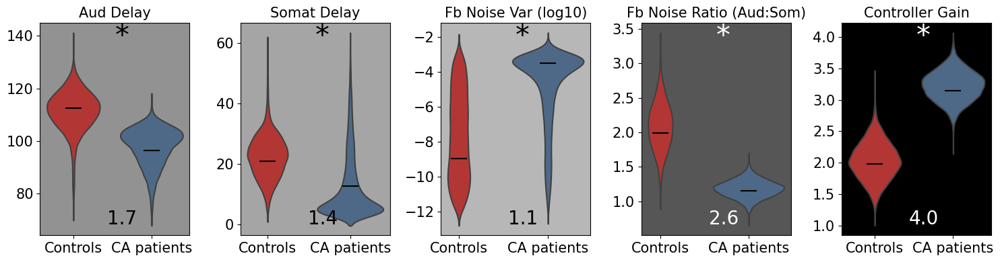

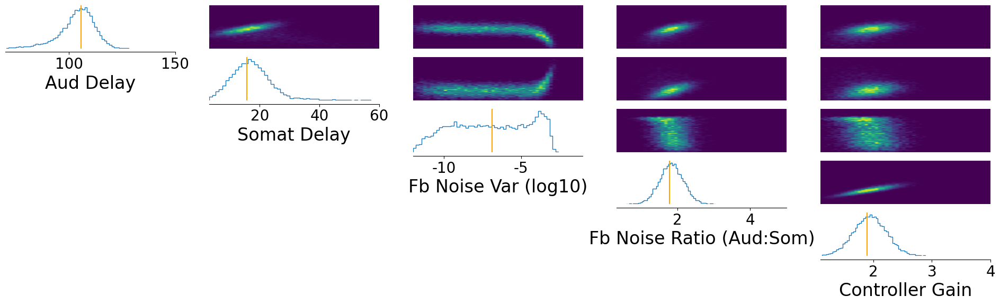

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([80.7354, 16.3119, -3.2474,  0.9322,  2.9642])


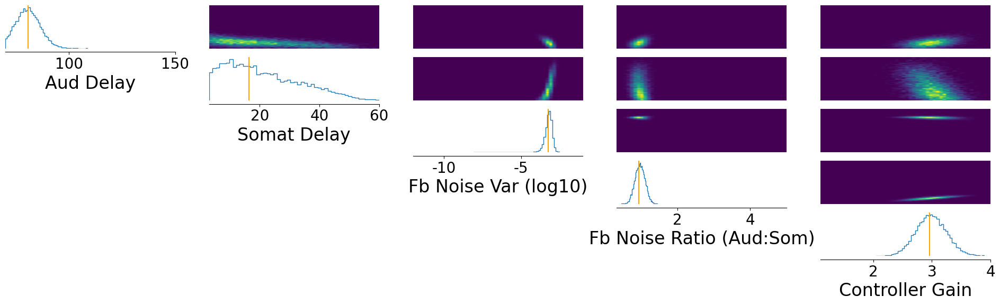

MSE: [0.40934484 2.79748798]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([105.0529,  25.8226,  -4.2282,   1.7741,   1.7713])


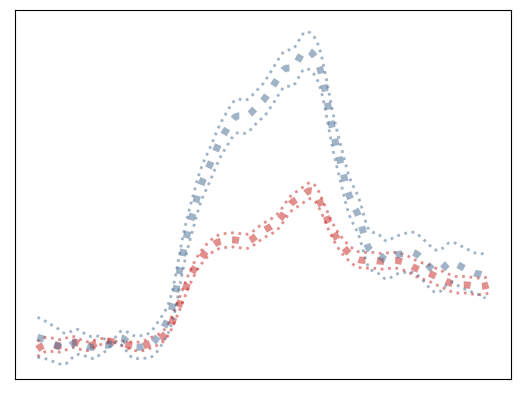

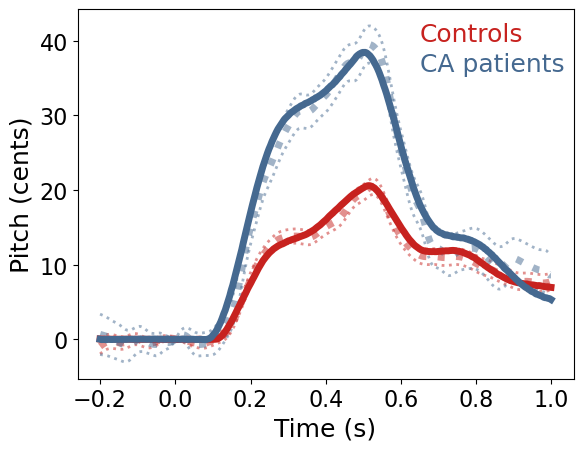

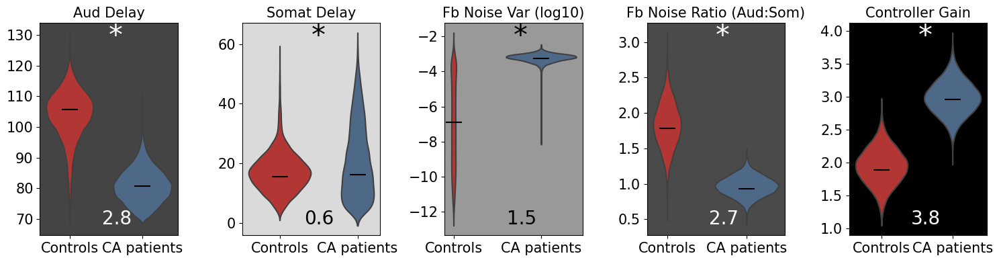

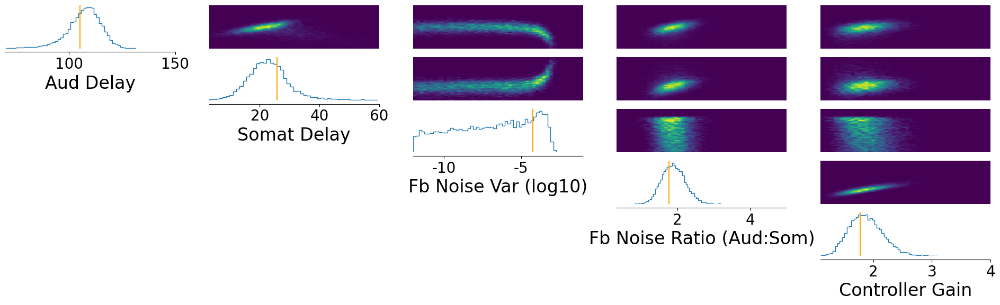

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([92.4592, 10.3847, -3.3627,  1.1235,  3.3095])


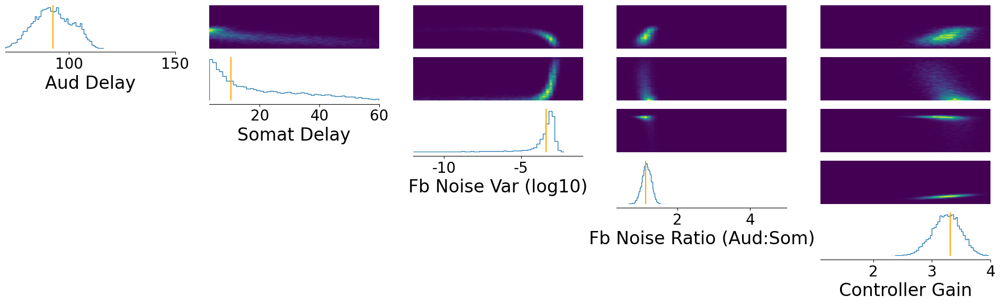

MSE: [0.316292   3.32413873]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.9071,  19.7739,  -9.1728,   1.8951,   2.0395])


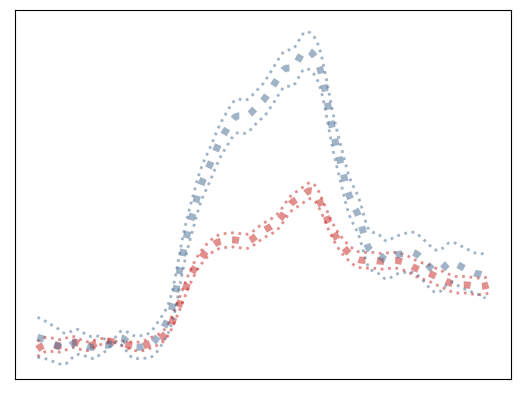

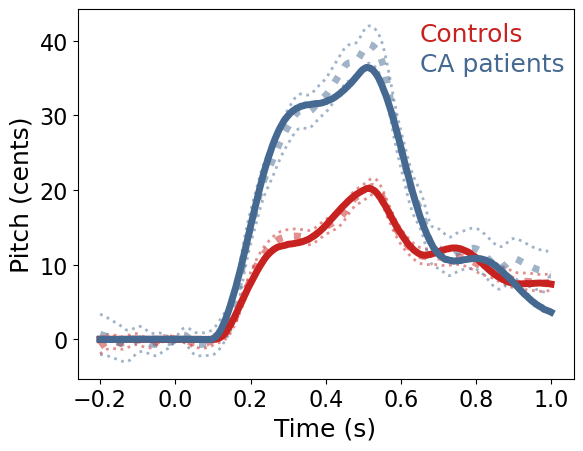

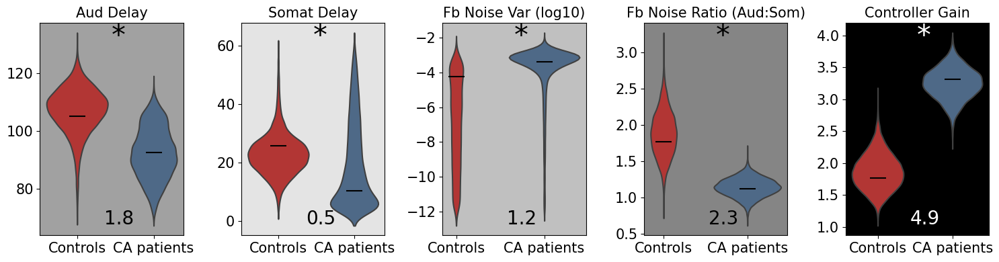

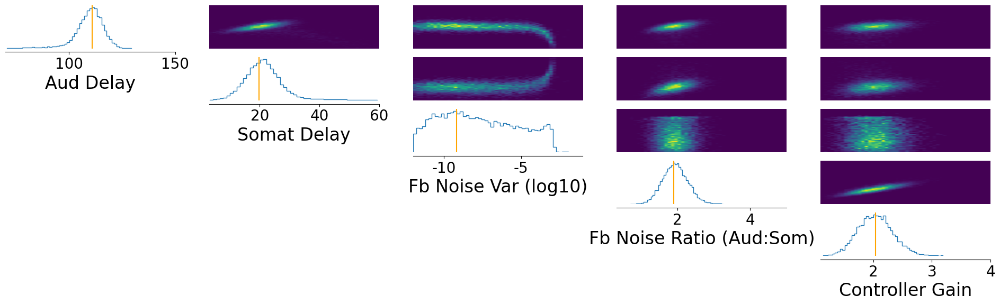

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([90.6939,  9.8323, -3.3961,  1.0260,  3.1444])


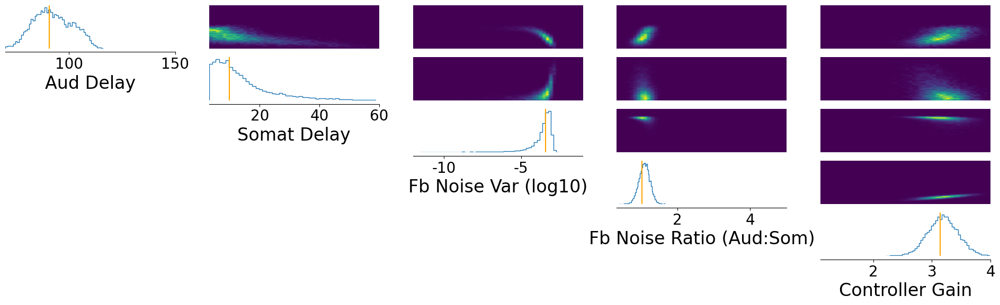

MSE: [0.48932998 2.28678709]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([113.4438,  22.1063,  -6.7953,   1.7539,   1.9301])


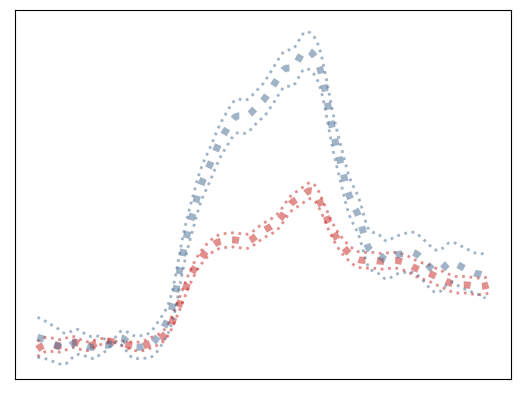

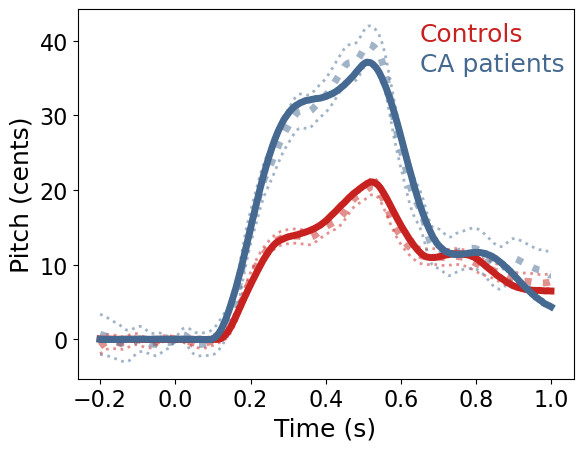

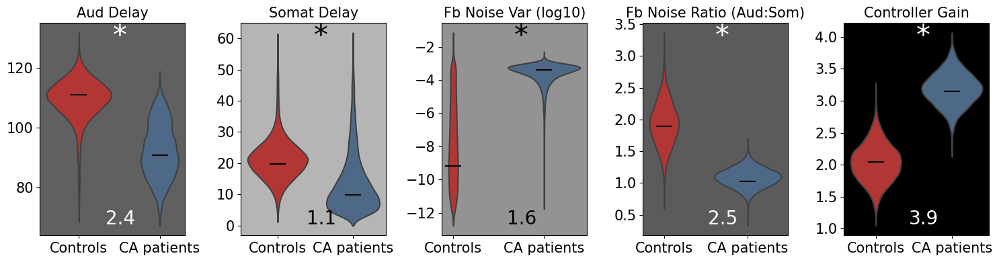

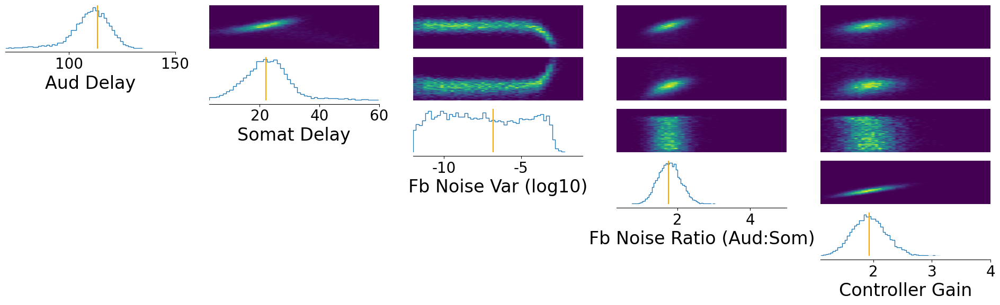

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([89.0395, 20.0552, -3.1315,  0.9362,  2.8369])


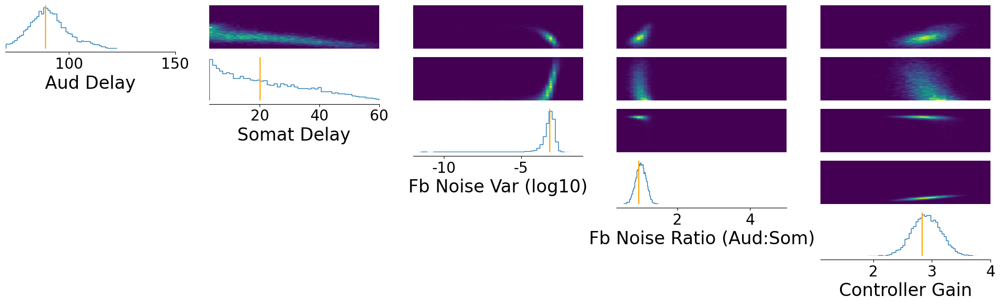

MSE: [0.73986878 2.26234533]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([107.9874,  21.4850,  -9.1057,   1.7189,   1.9068])


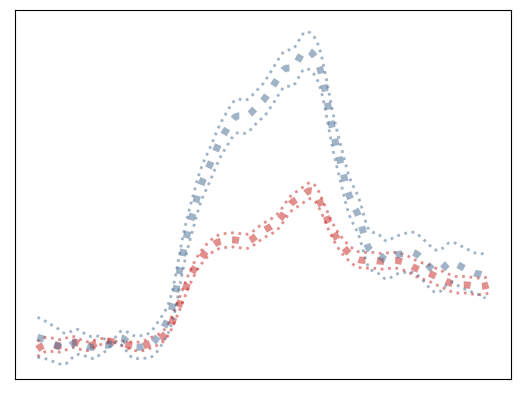

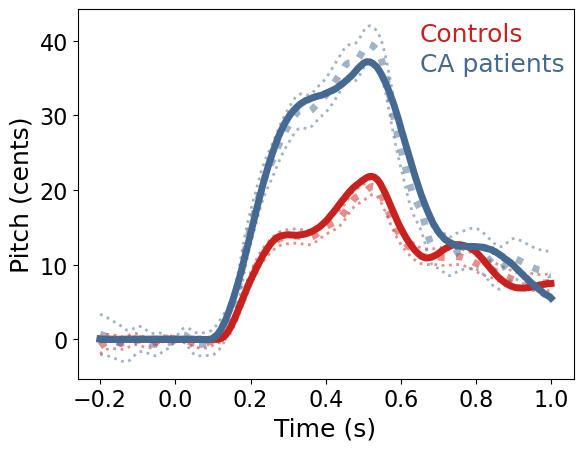

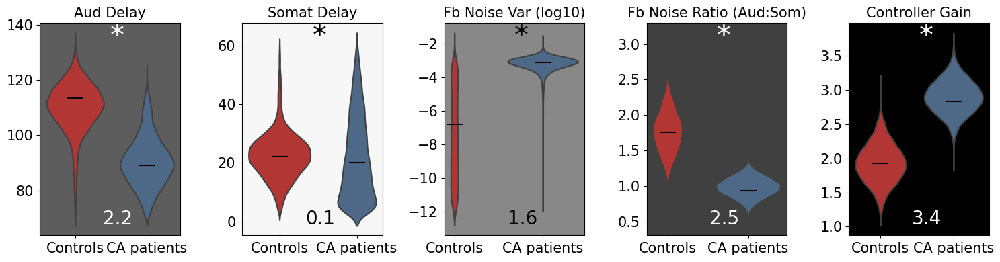

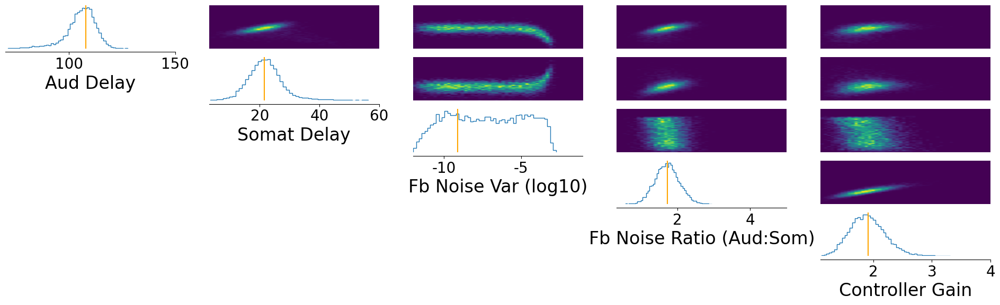

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([78.9413, 19.1828, -3.0672,  0.7958,  2.7745])


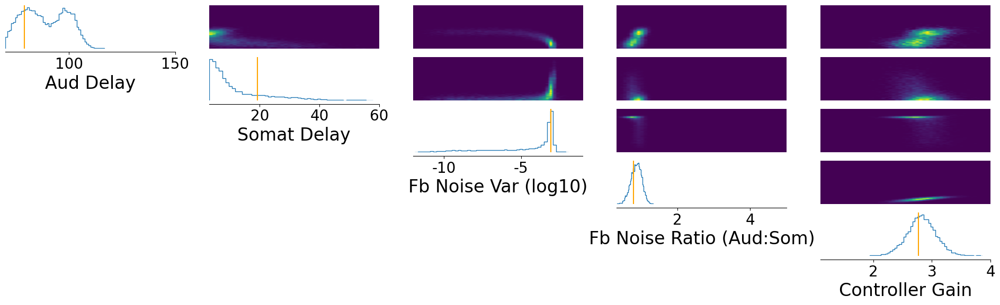

MSE: [0.70173159 4.78931746]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.4697,  22.9059,  -6.3183,   1.9591,   2.0055])


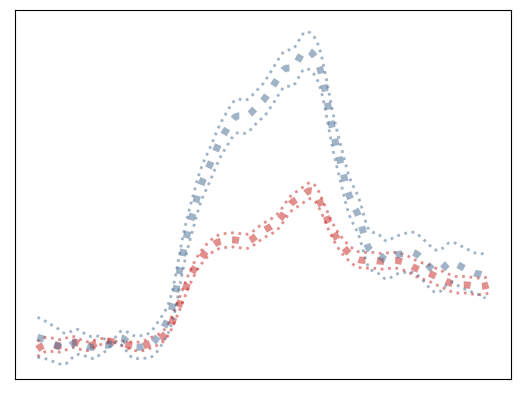

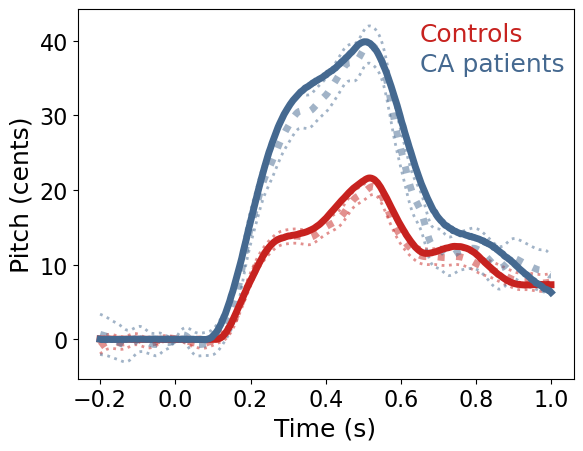

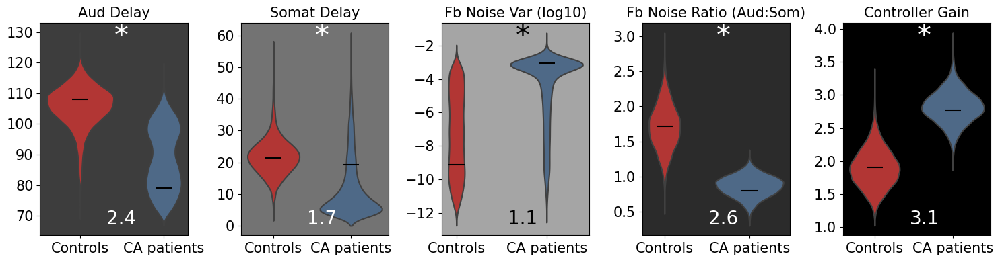

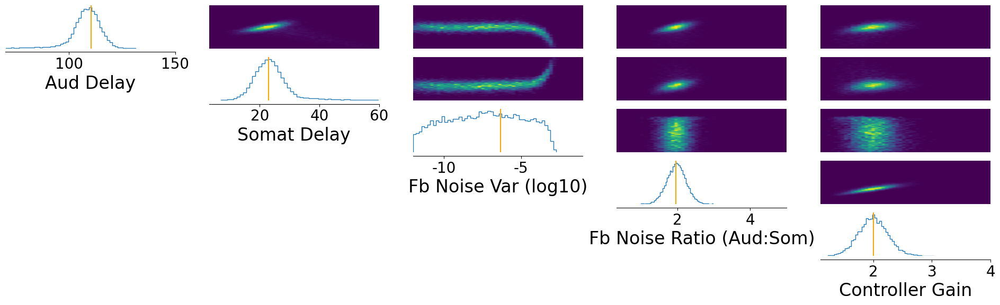

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.9559,  3.6754, -4.4762,  1.2294,  3.3339])


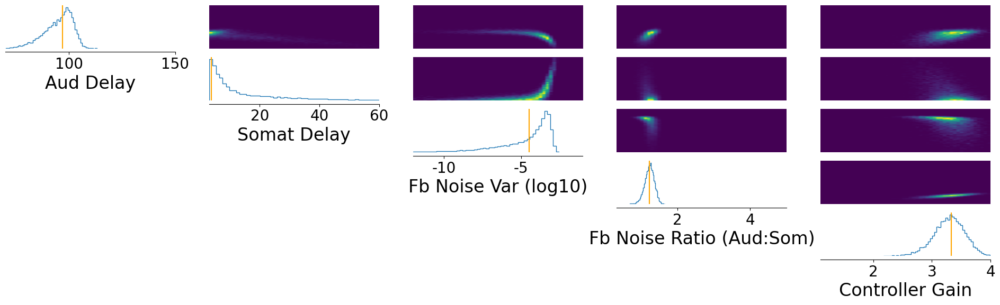

MSE: [0.32411422 8.33147797]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.9994,  23.4347, -10.4370,   1.8128,   1.7675])


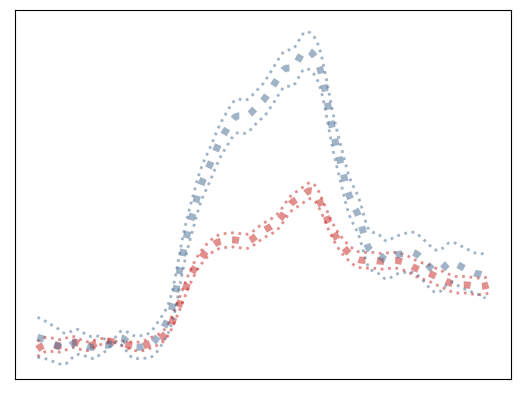

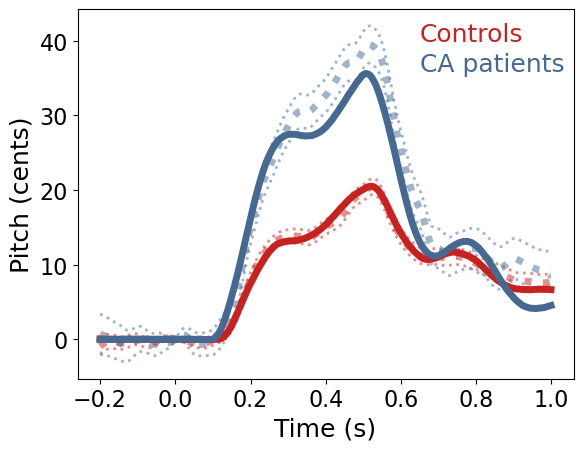

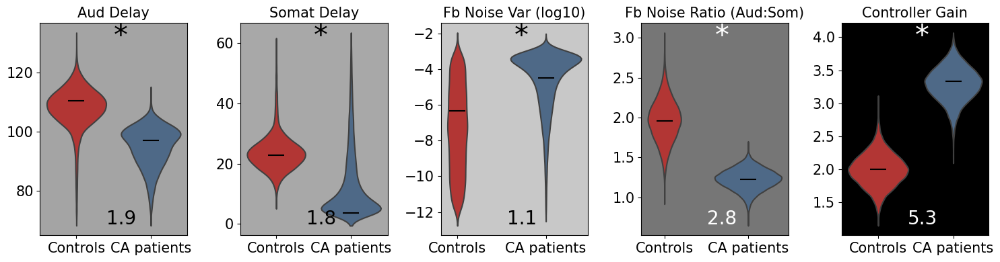

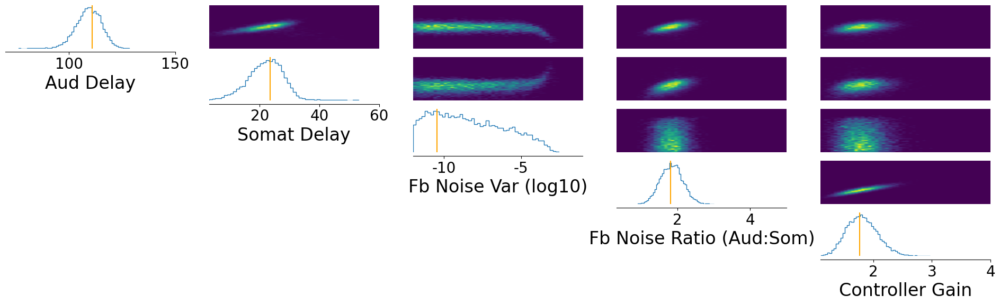

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.5217, 18.7802, -3.2144,  1.0004,  2.9121])


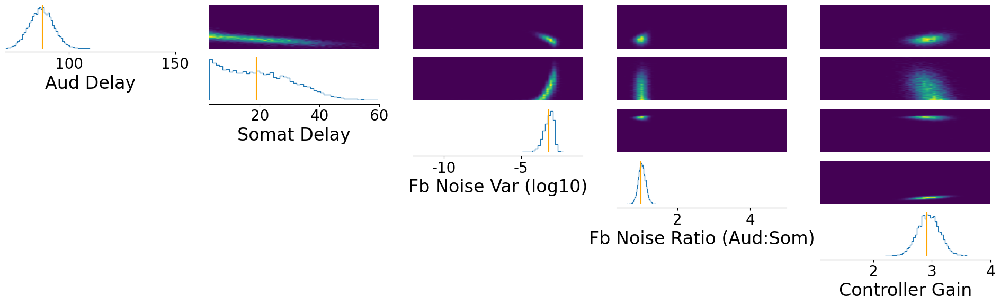

MSE: [0.36312079 2.22281792]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.0637,  23.2738,  -9.8436,   1.8365,   1.9373])


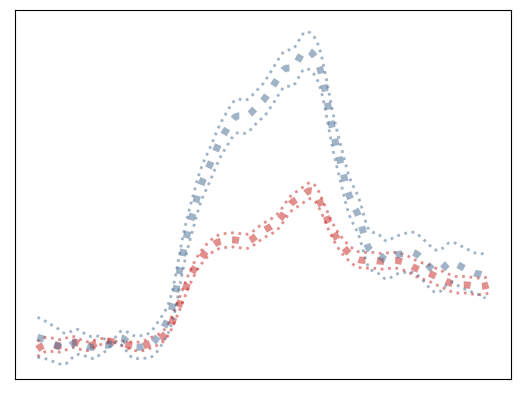

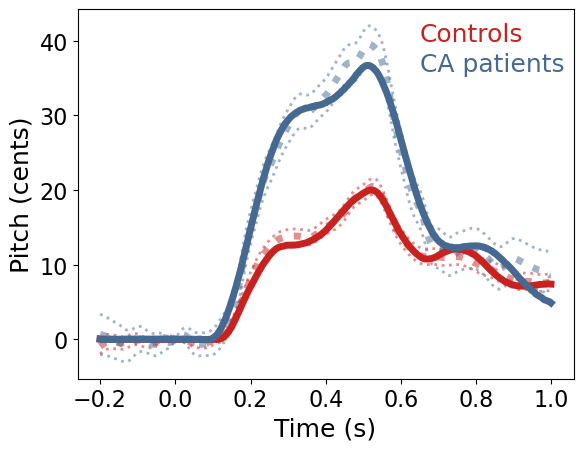

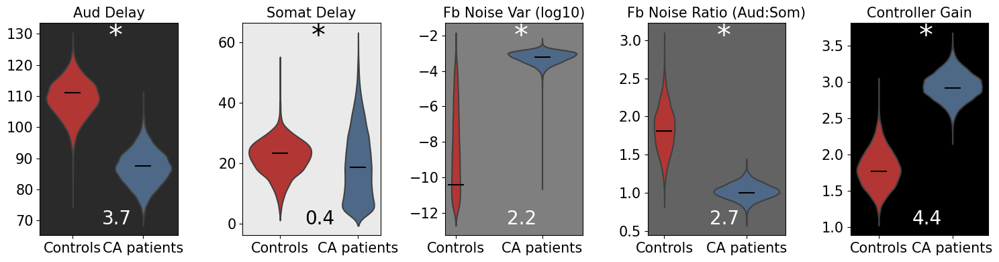

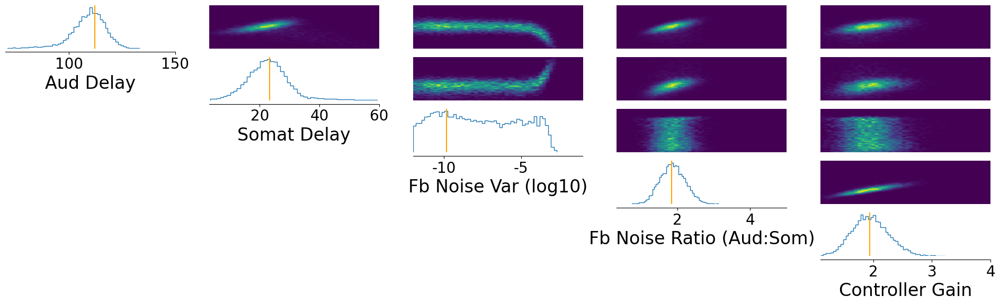

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([90.6799, 11.9193, -3.5301,  0.9718,  2.9831])


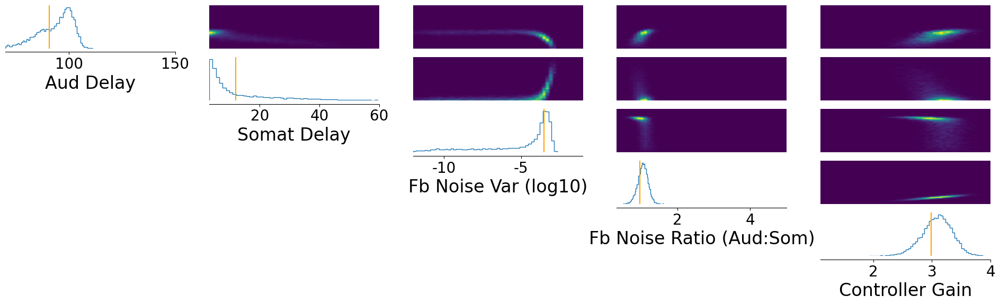

MSE: [0.40220999 3.0395478 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([115.9794,  23.4556,  -8.4183,   2.0119,   2.0242])


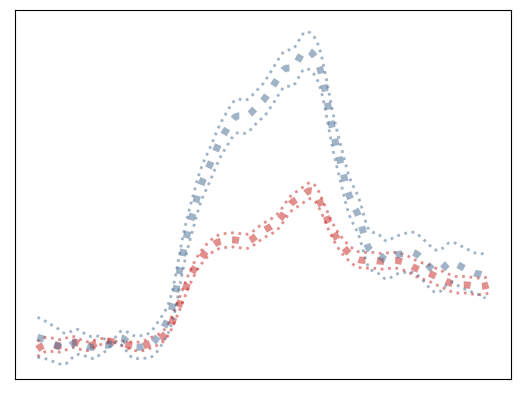

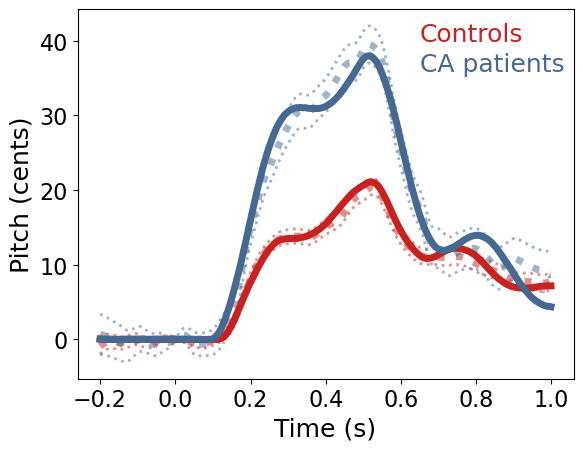

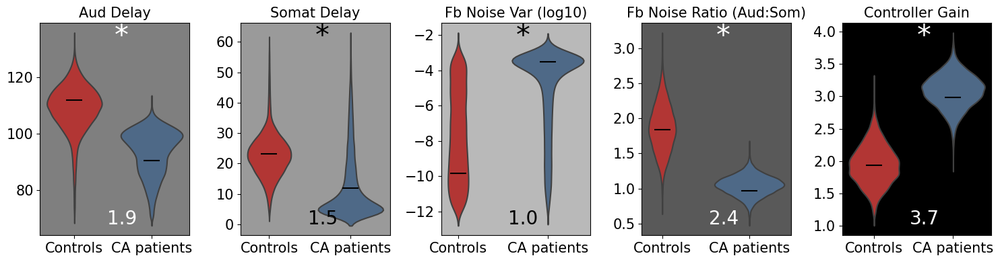

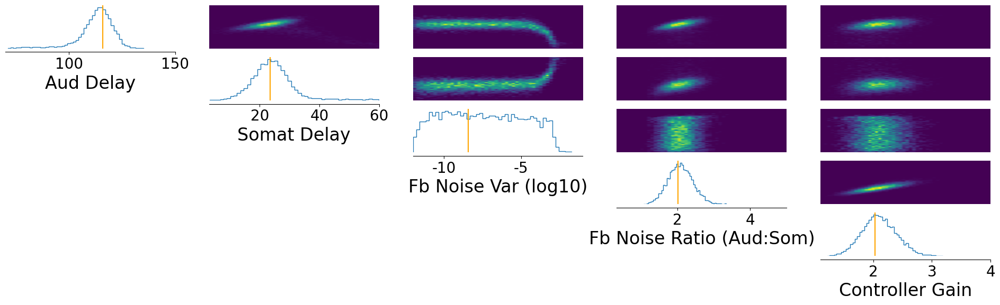

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.5805, 31.4873, -3.0425,  1.0914,  3.0167])


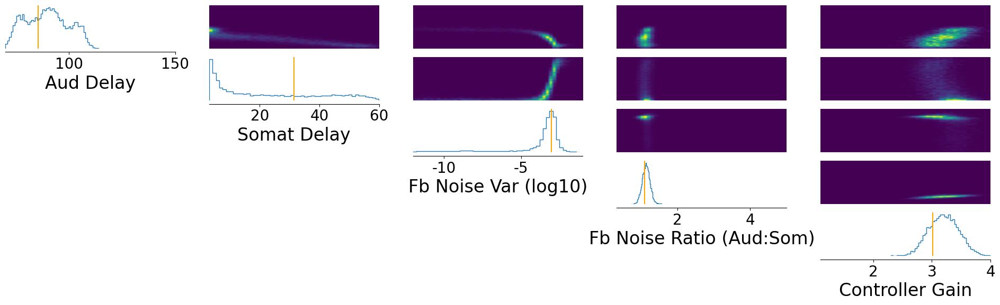

MSE: [0.40613143 3.03627264]


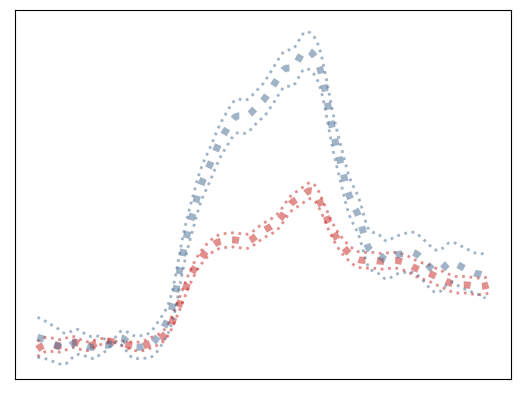

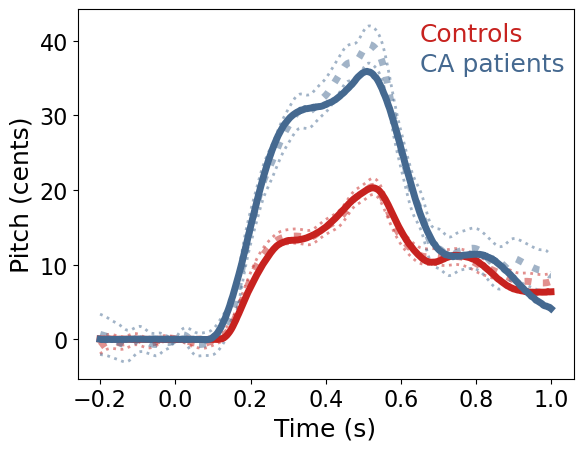

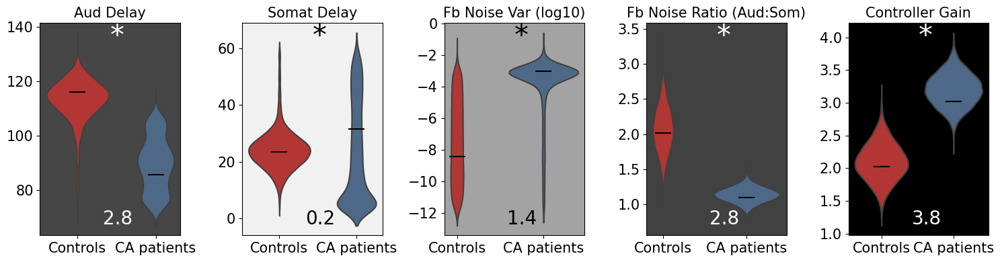

In [18]:
def simulator(parameter_set):
    training_noise_scale = 3
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

prior_min_all = [70, 3, -12, 0.3333, 1.1]
prior_max_all = [150, 60, -1, 5, 4]
data_list,inferred_control_values_all, mse_vals[0,:,:] = run_sbi('training_noise_3',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([108.4892,  20.2240,  -4.8272,   1.6888,   1.8099])


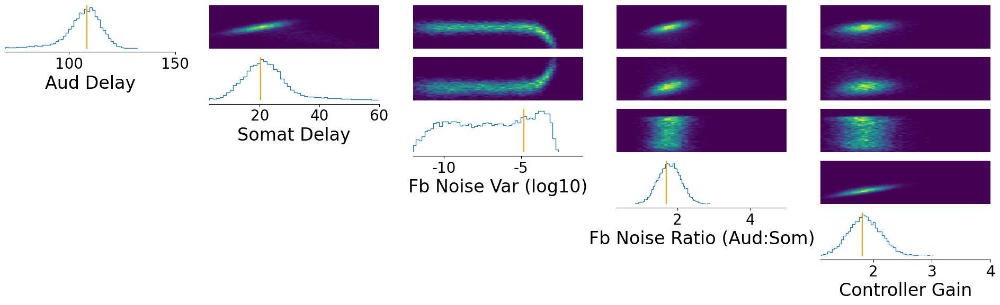

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.3774, 28.2268, -3.1359,  0.9948,  2.7569])


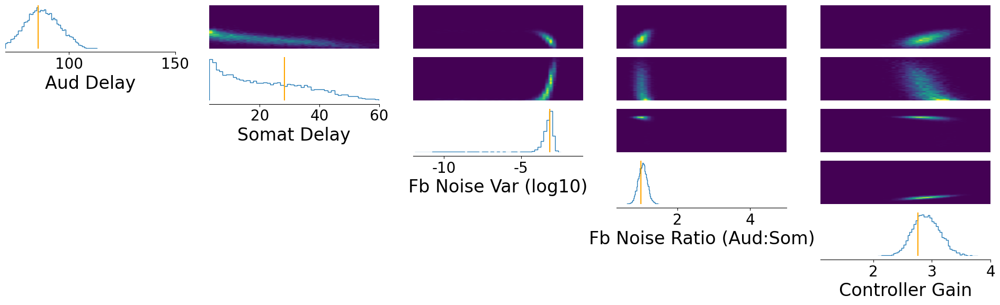

MSE: [0.52497482 2.77270167]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([107.6418,  13.2736, -10.0394,   2.0846,   2.2004])


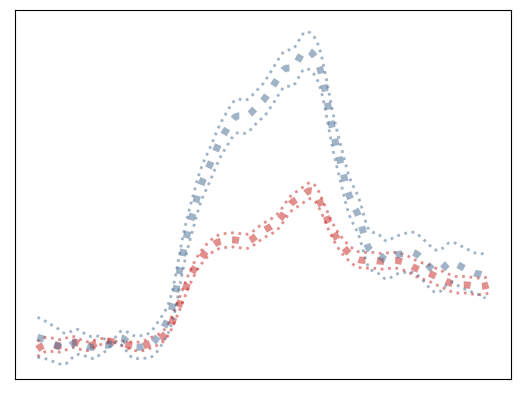

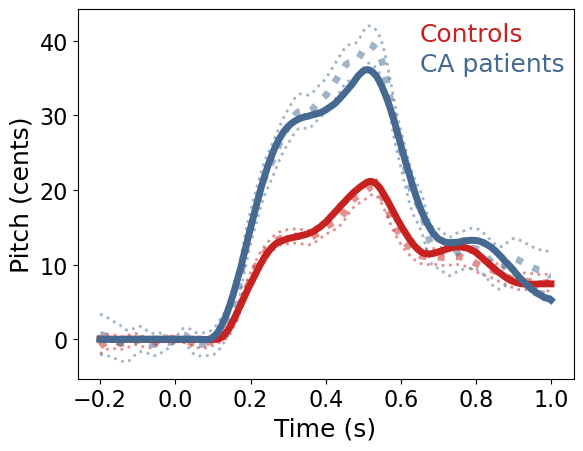

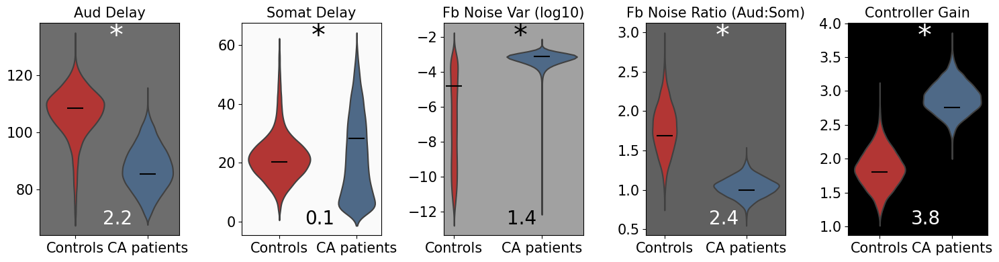

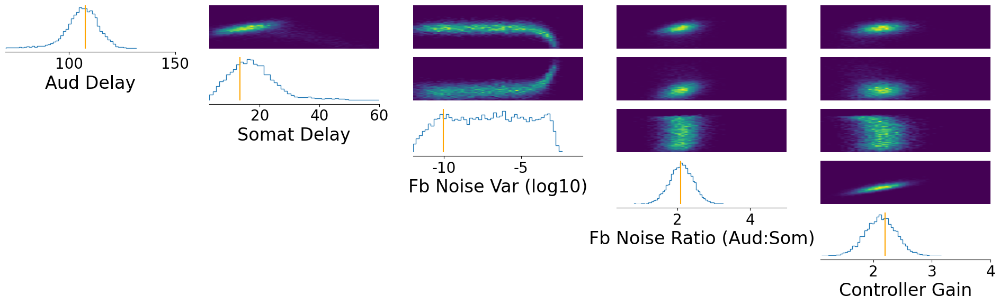

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.2198, 12.6855, -3.2131,  1.0396,  3.1037])


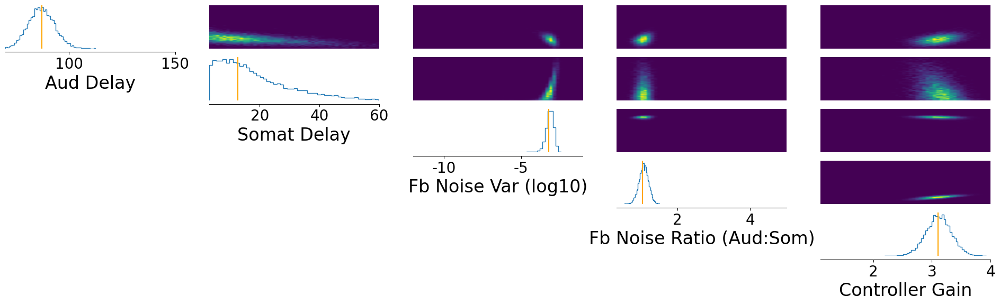

MSE: [0.68138876 2.24543576]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.0550,  25.2233,  -4.0742,   1.8977,   2.0110])


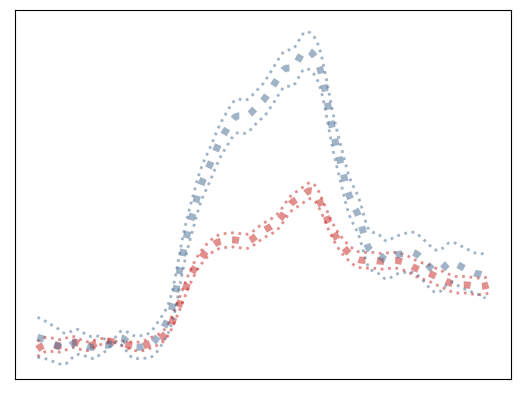

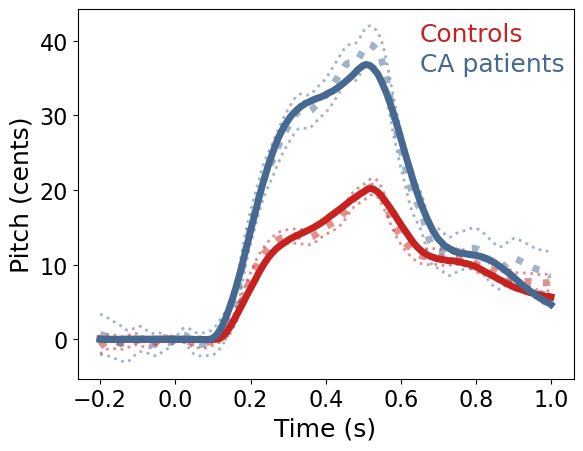

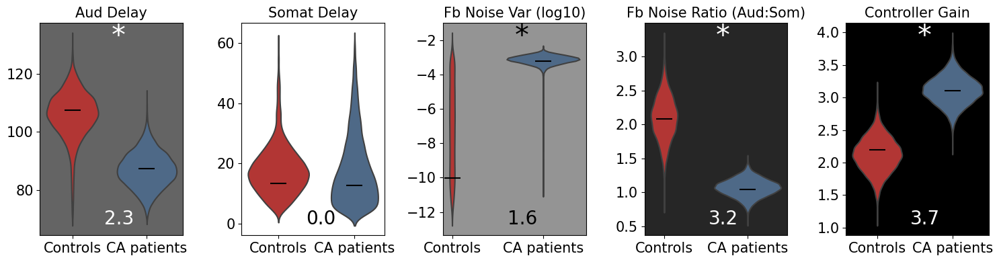

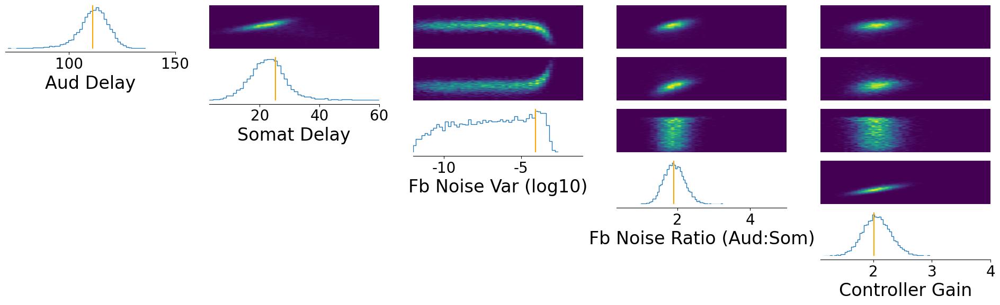

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([92.6202,  9.2114, -3.5540,  1.0332,  3.0058])


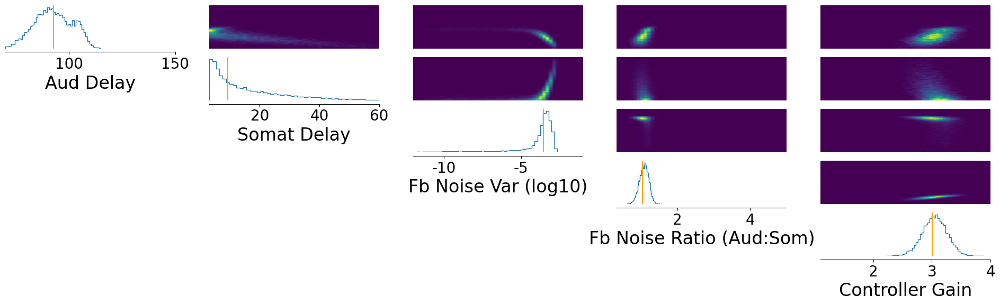

MSE: [0.60498939 2.77858064]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.2253, 14.7544, -4.3040,  1.3615,  1.5582])


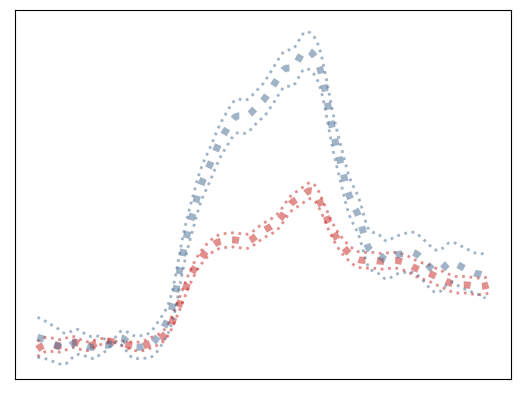

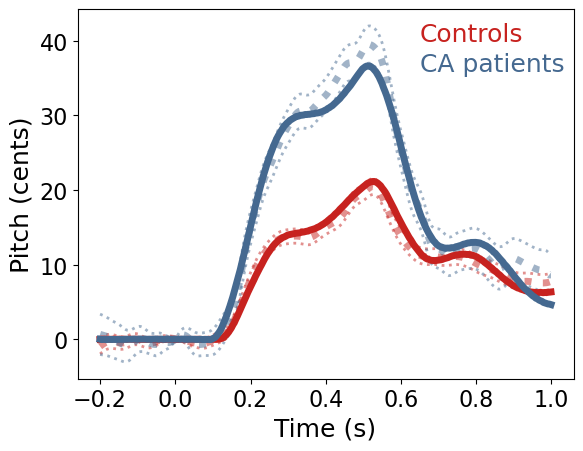

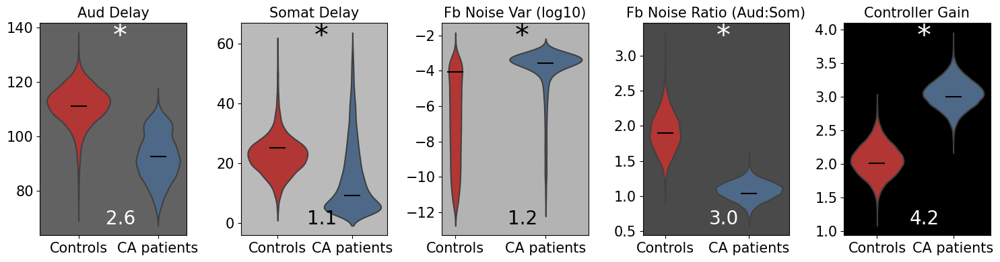

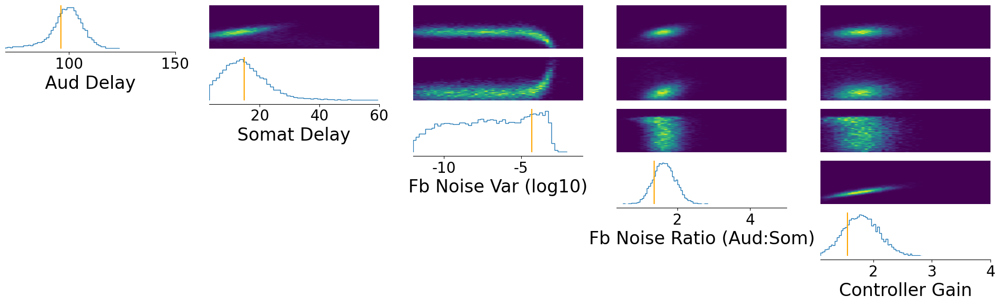

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([88.1822, 14.0983, -3.4033,  0.9541,  2.9773])


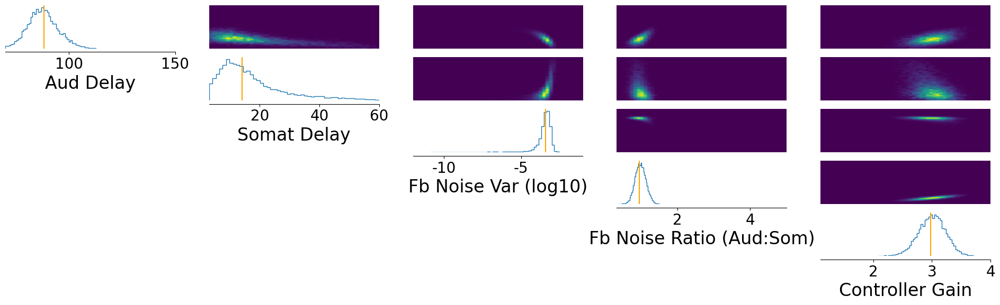

MSE: [1.65400809 2.98200565]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([104.8576,  16.5538, -10.0919,   1.6726,   1.7394])


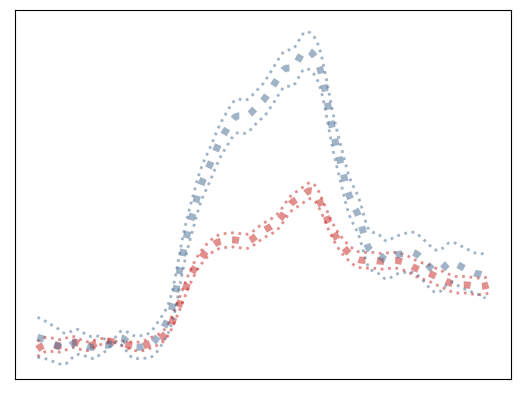

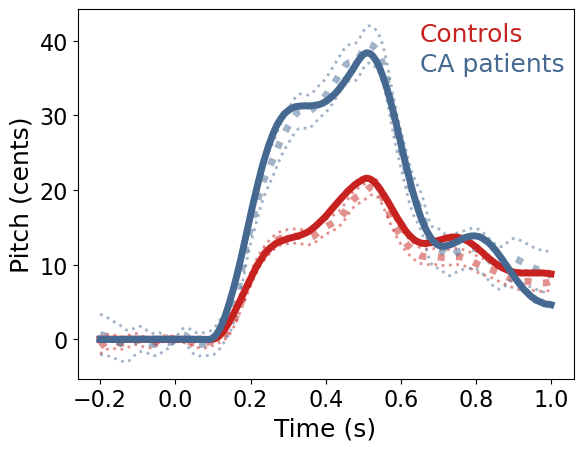

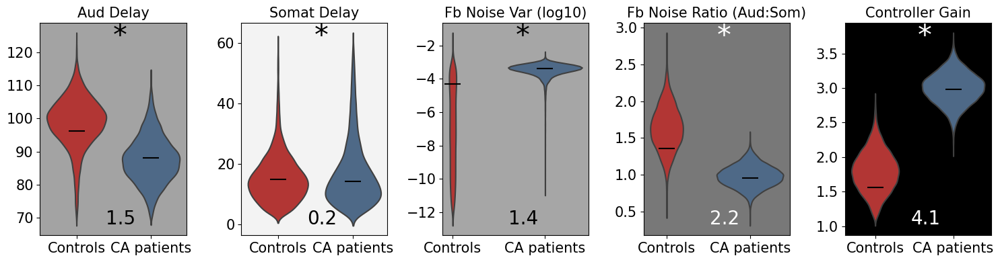

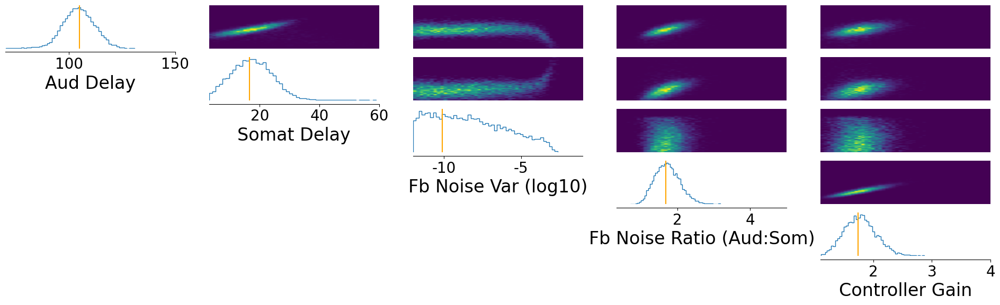

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.9979, 11.3042, -3.2289,  0.9388,  2.9759])


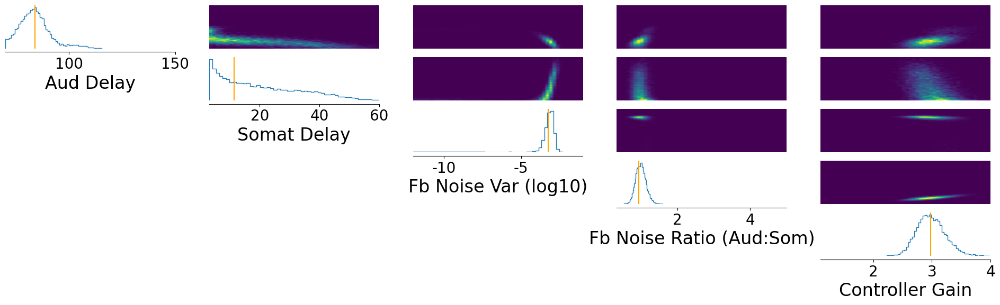

MSE: [0.43997989 2.25911923]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.1710,  20.2677,  -9.7287,   1.9466,   1.9843])


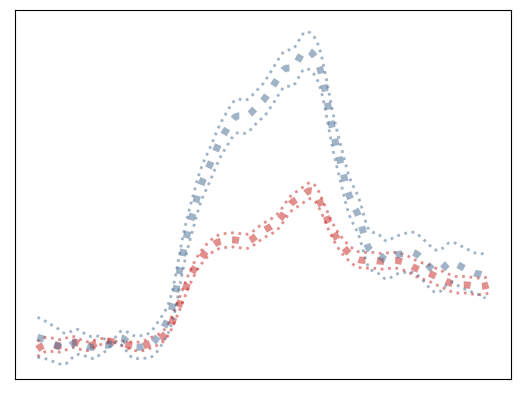

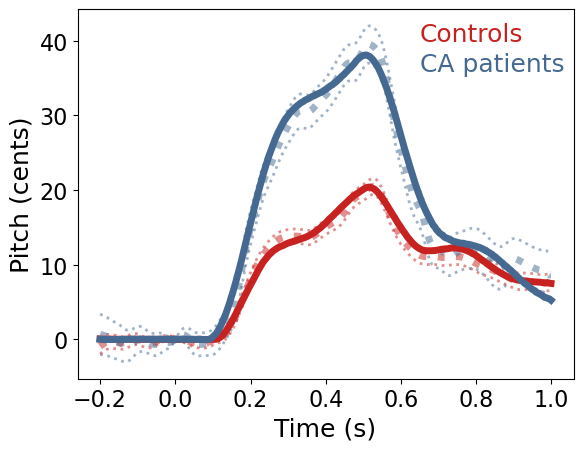

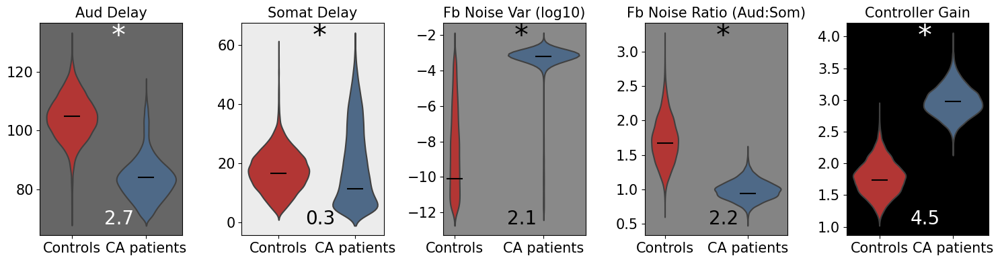

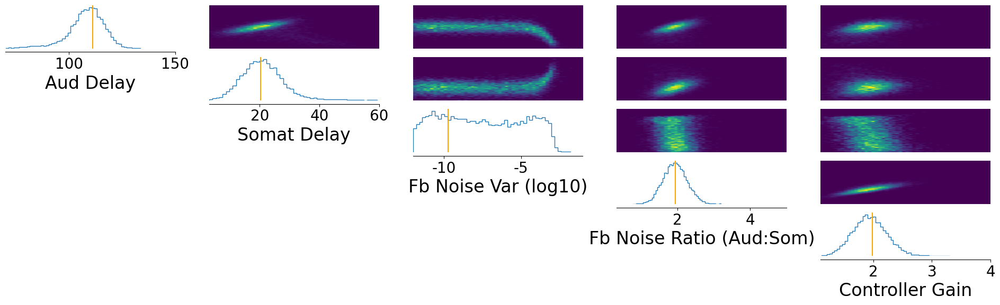

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.5514,  7.0530, -3.4821,  1.0055,  3.0128])


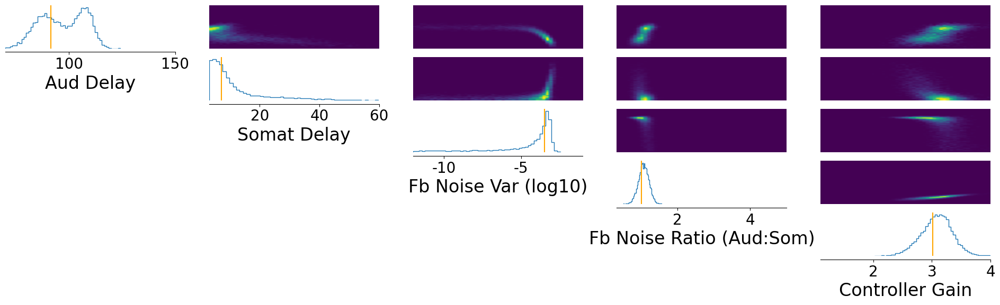

MSE: [0.35455987 2.31066887]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.9148,  23.7049,  -7.1025,   1.7081,   1.7833])


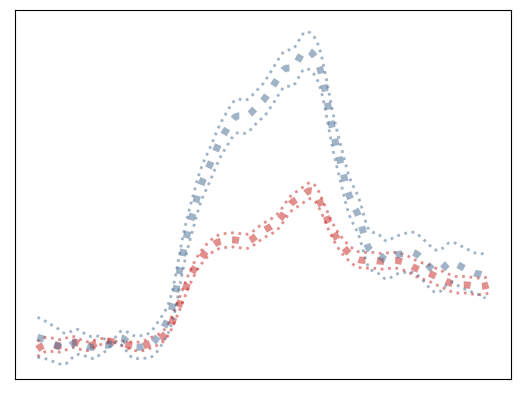

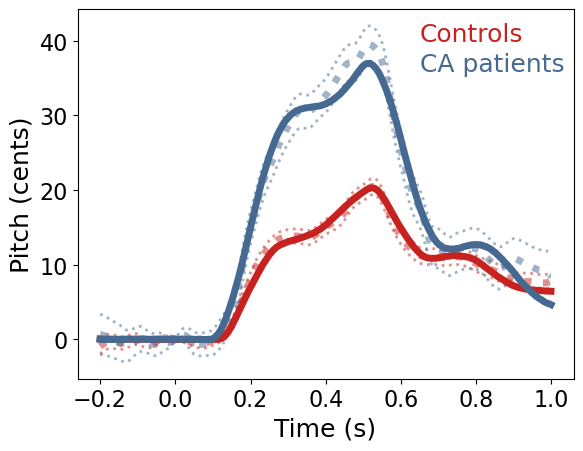

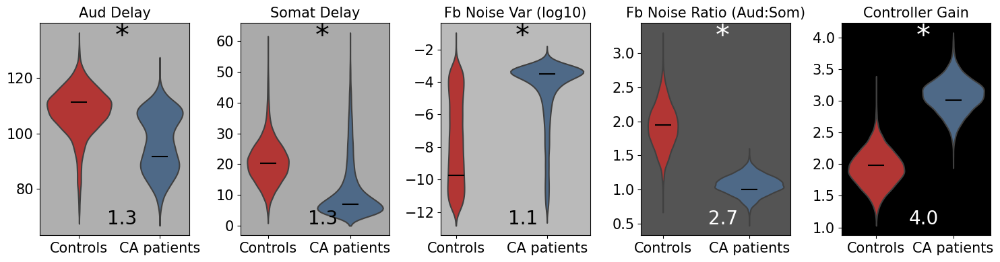

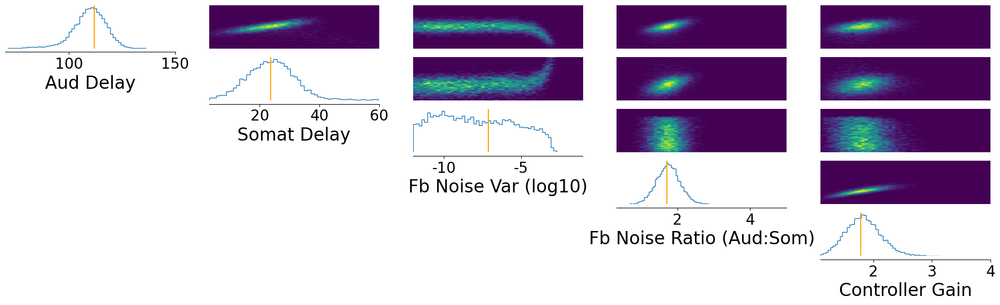

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.9506, 16.5028, -3.2739,  0.8184,  2.8369])


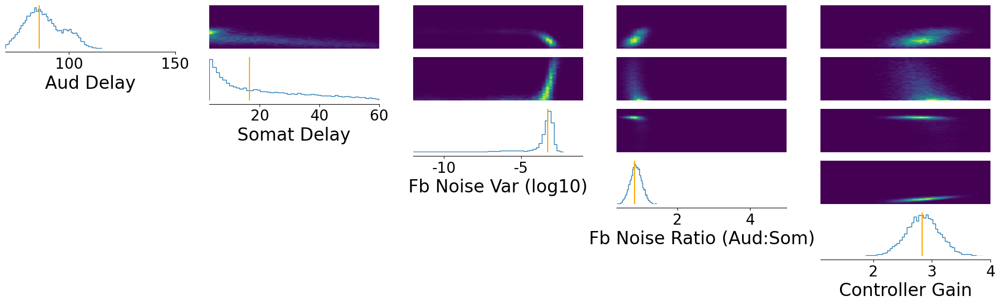

MSE: [0.47987291 4.06702949]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([102.8145,  24.6531,  -4.1471,   1.7370,   1.7706])


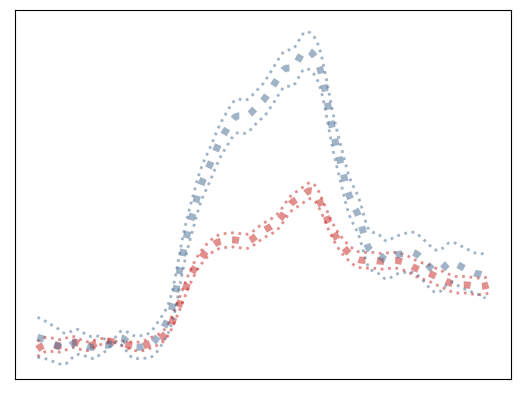

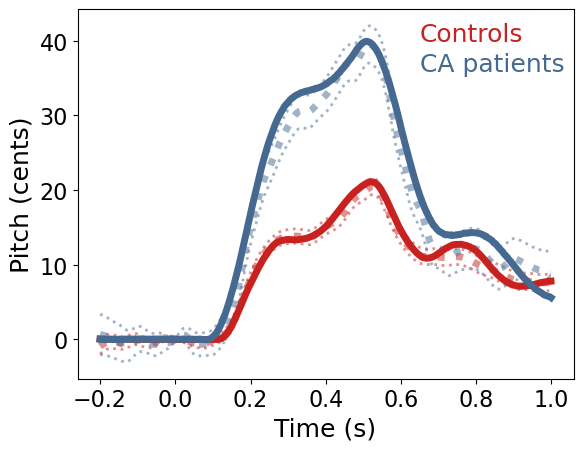

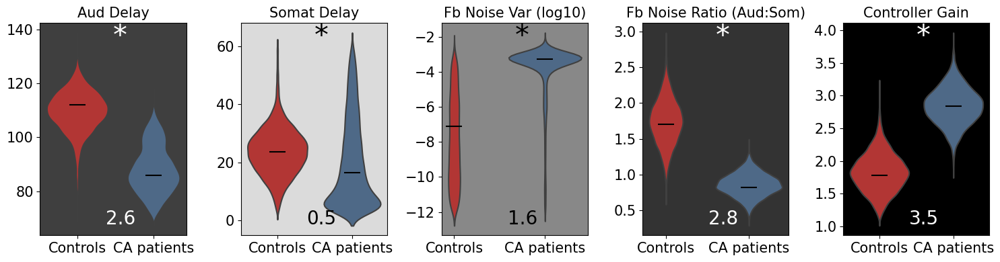

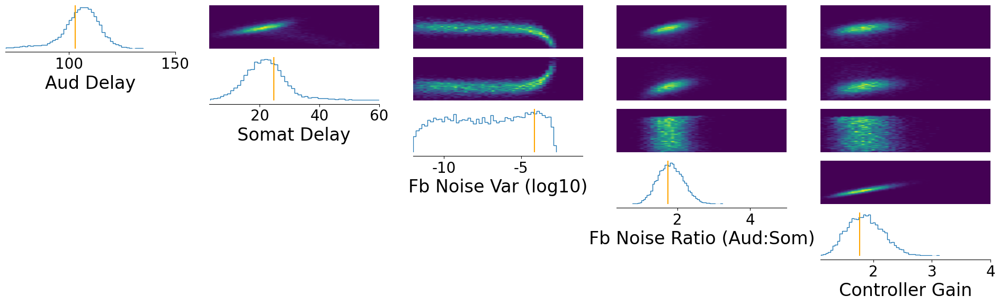

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([81.4016, 26.4749, -3.0659,  0.9335,  2.8682])


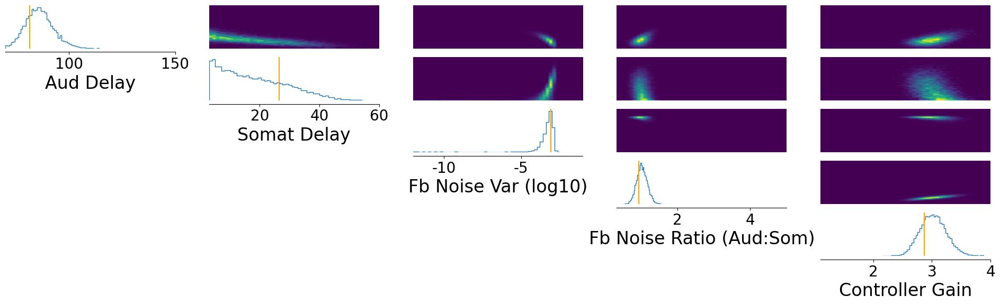

MSE: [0.33916234 2.29814204]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.8030,  18.1243,  -9.8769,   1.8434,   2.0023])


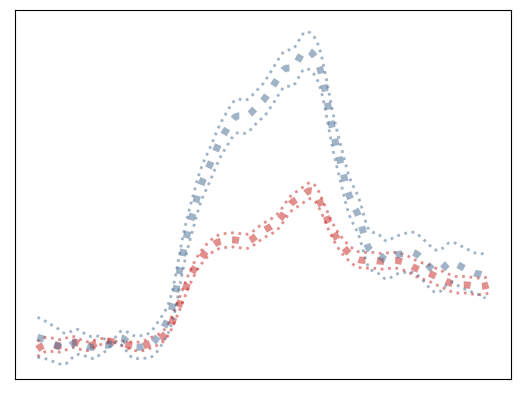

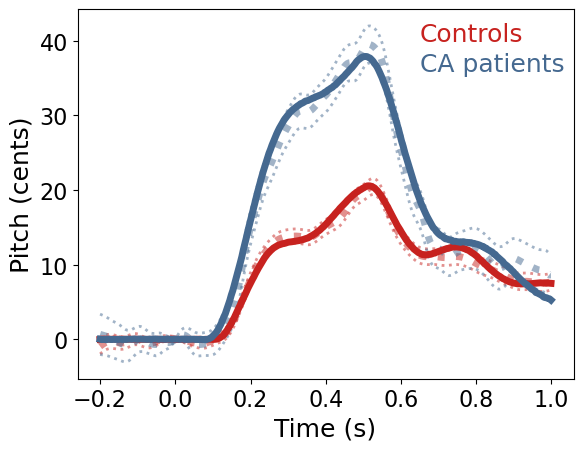

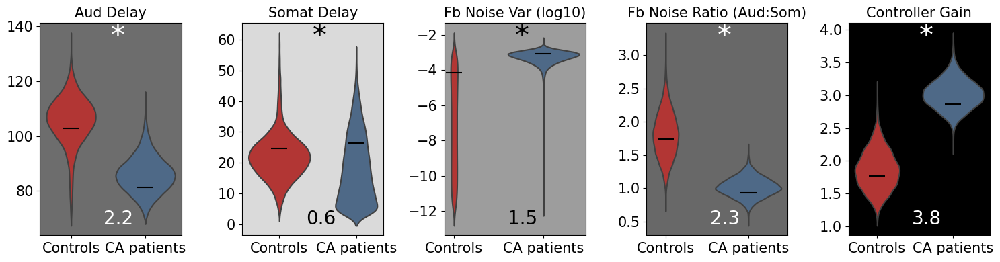

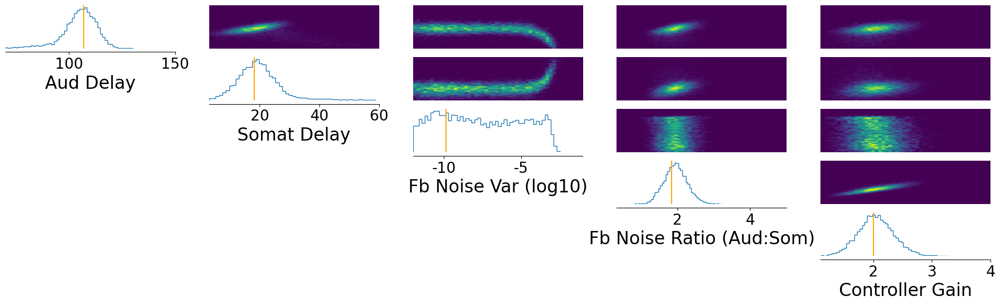

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([86.9381, 17.7888, -3.2899,  0.9391,  3.0033])


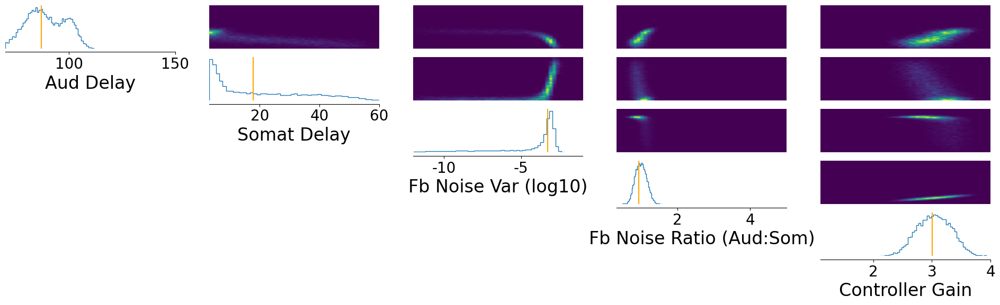

MSE: [0.49218328 2.54975258]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([113.7973,  20.6376,  -8.3013,   1.7800,   1.8592])


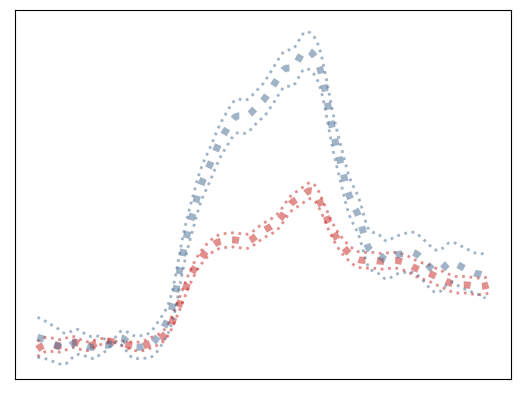

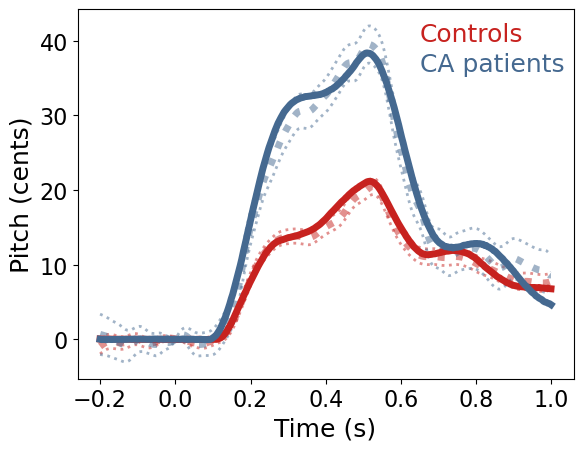

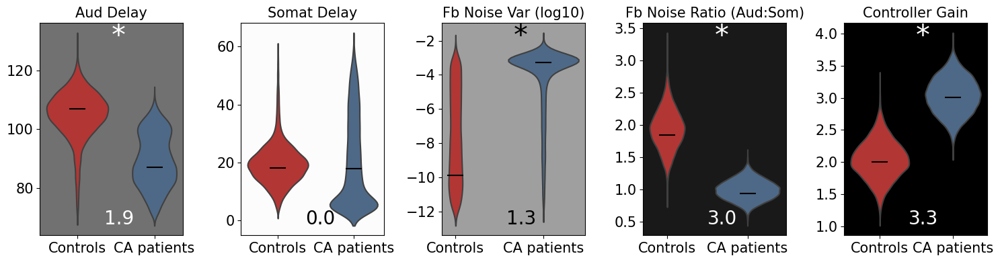

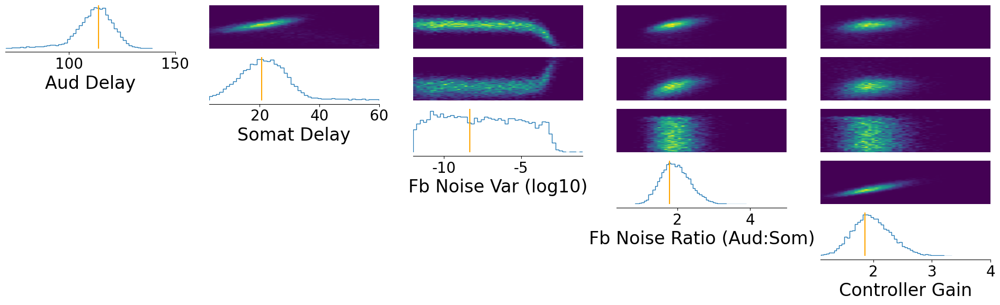

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.3813, 12.5387, -3.4157,  1.0322,  3.0281])


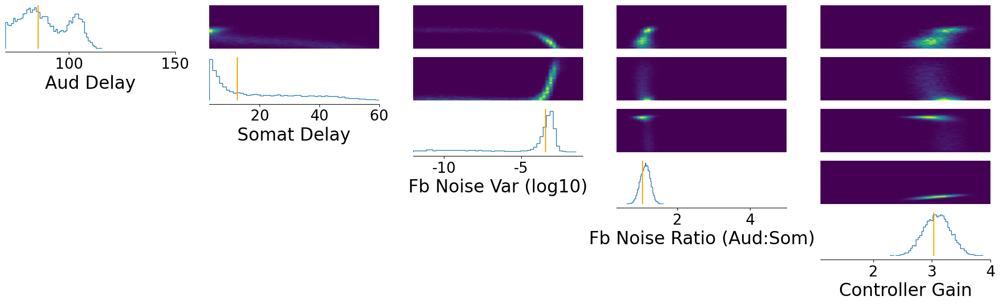

MSE: [0.40812711 3.18874017]


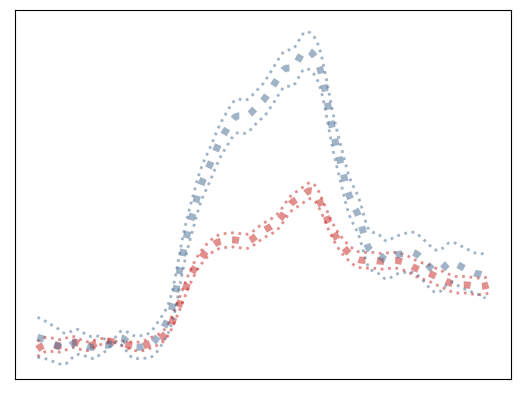

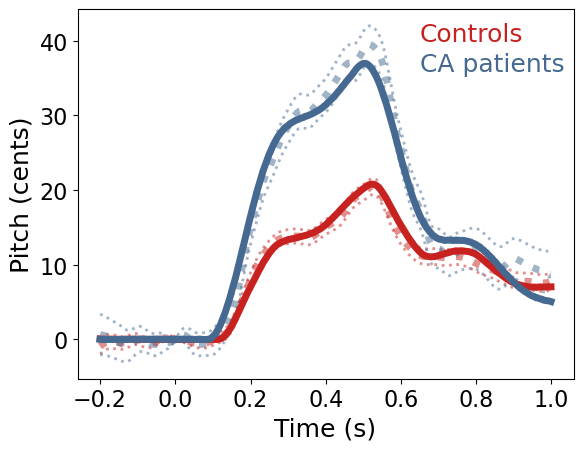

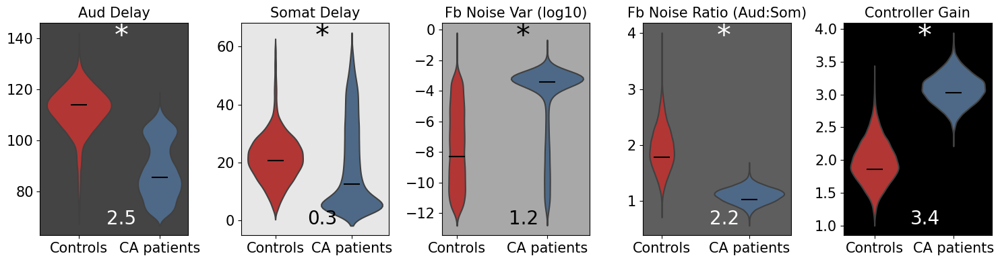

In [19]:
def simulator(parameter_set):
    training_noise_scale = 5
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

data_list,inferred_control_values_all, mse_vals[1,:,:] = run_sbi('training_noise_5',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([105.2173,  19.3672,  -5.1999,   1.7460,   1.8245])


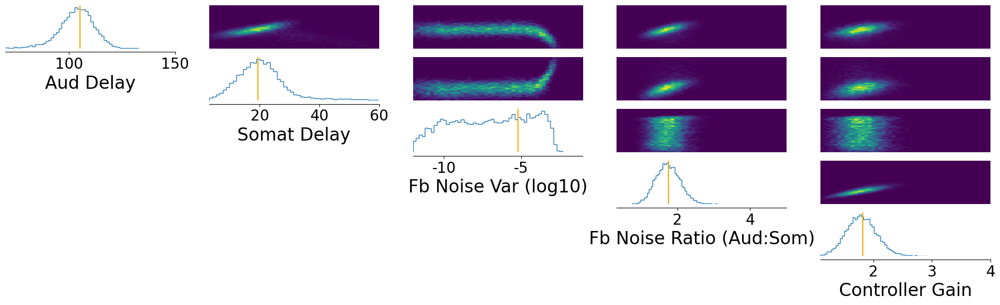

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.3398,  3.4423, -3.8422,  1.0734,  3.0339])


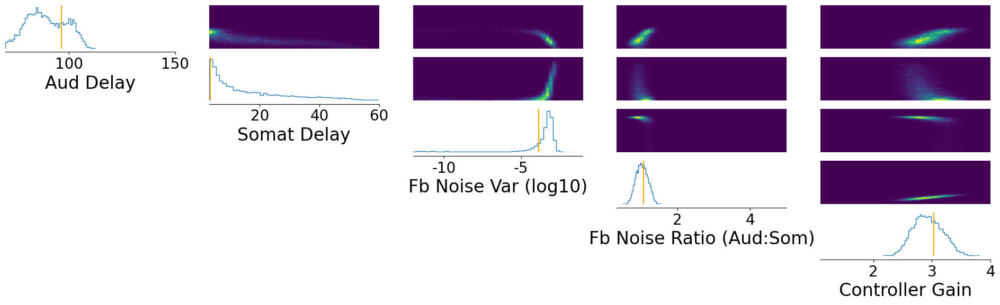

MSE: [0.39527258 3.86254061]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.9375, 38.3661, -3.1893,  1.6407,  1.7363])


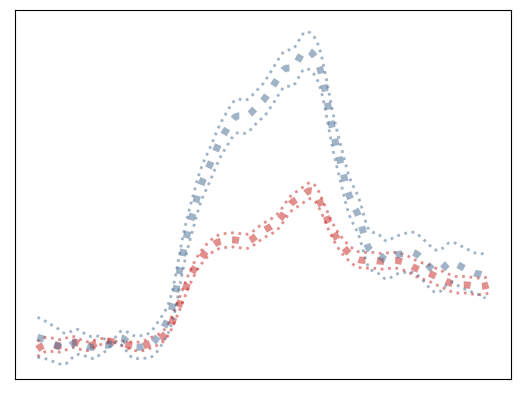

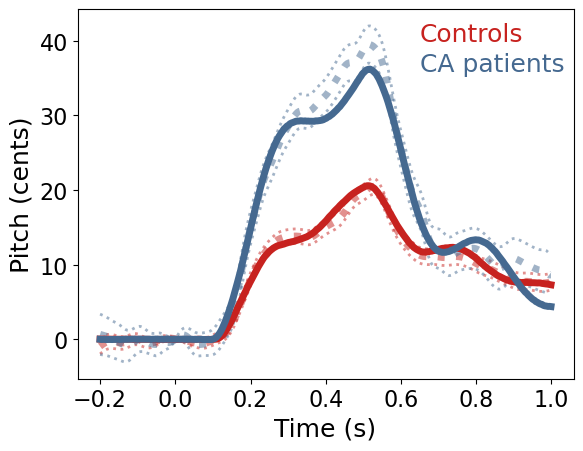

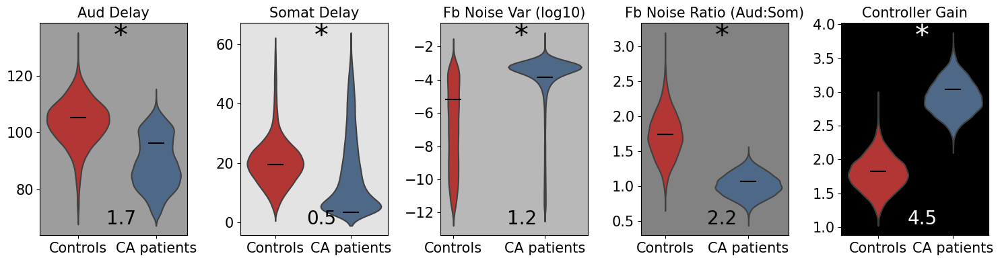

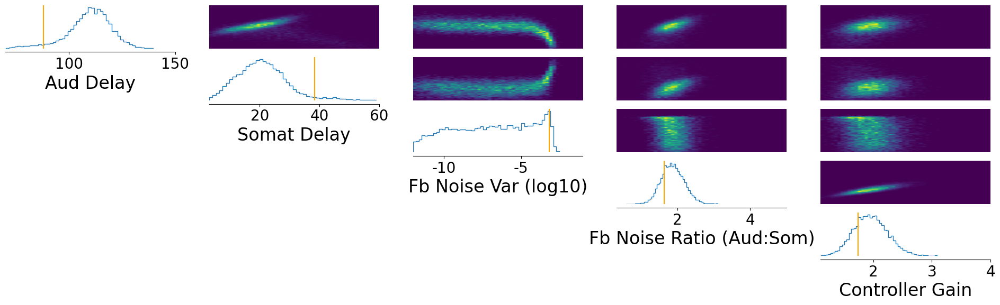

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([86.3581, 16.6116, -3.2457,  0.9794,  2.9626])


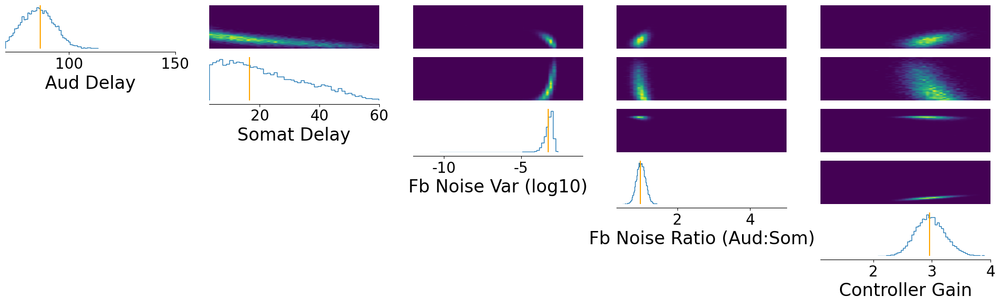

MSE: [0.84612618 2.07132024]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([114.1260,  24.4342,  -8.2442,   1.8840,   1.9295])


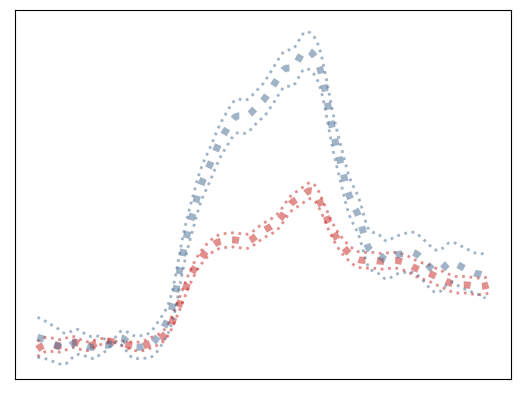

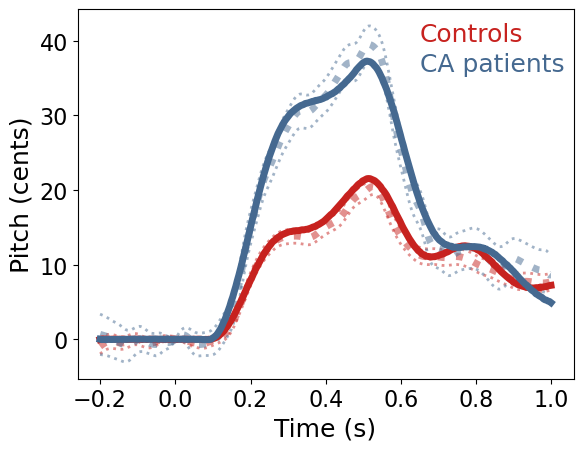

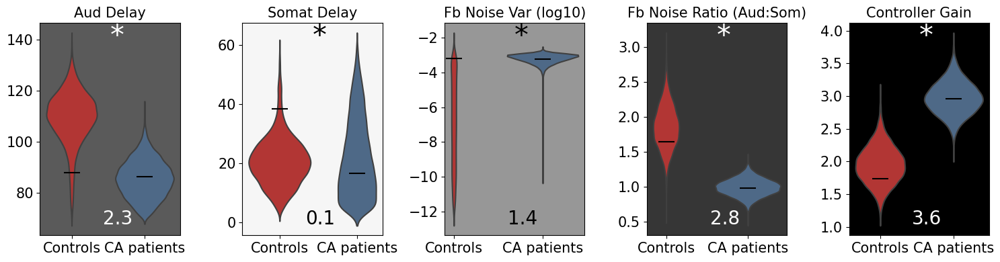

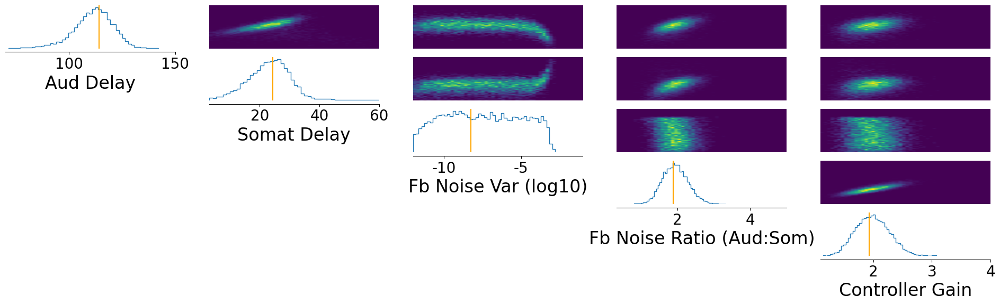

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.4740, 19.1213, -3.3203,  1.0962,  2.9611])


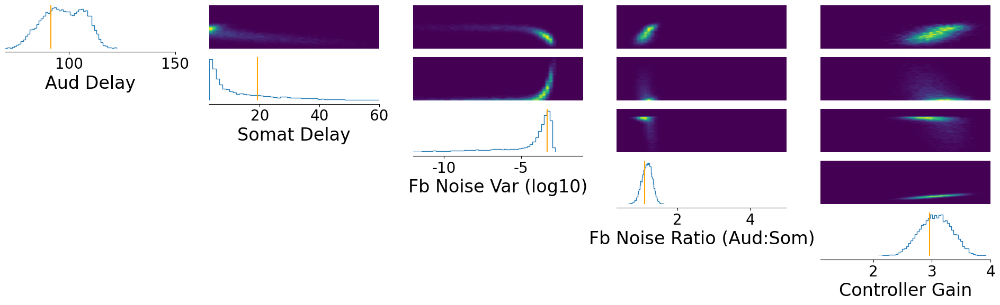

MSE: [0.39609766 3.78733869]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.3000,  19.9365,  -9.2398,   2.0269,   2.1082])


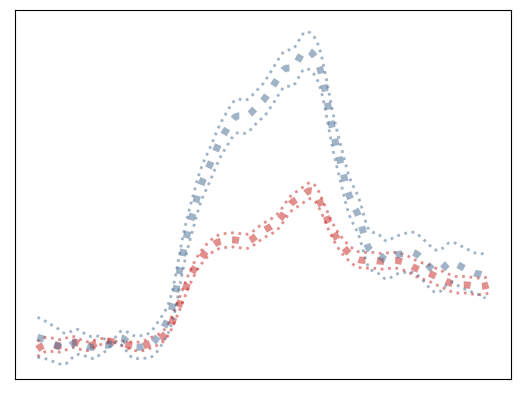

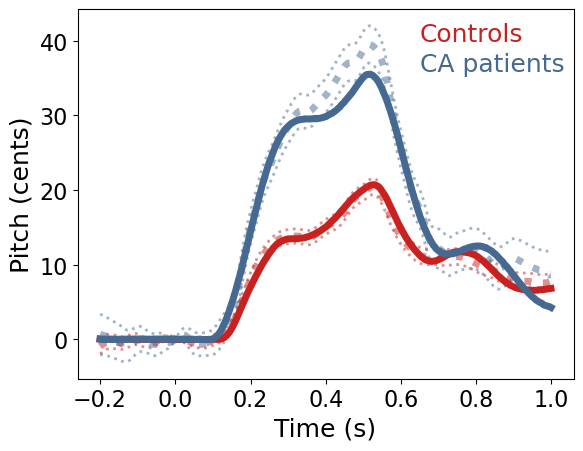

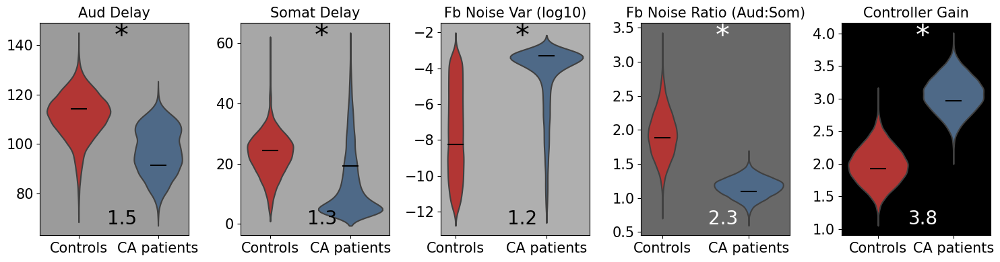

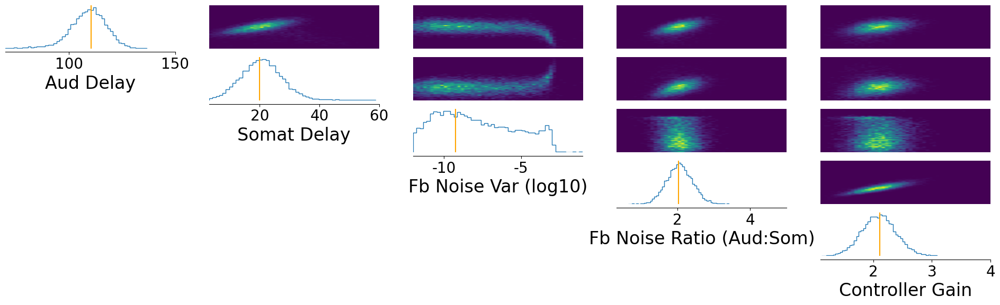

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([90.1768, 11.5978, -3.3181,  1.0448,  3.0042])


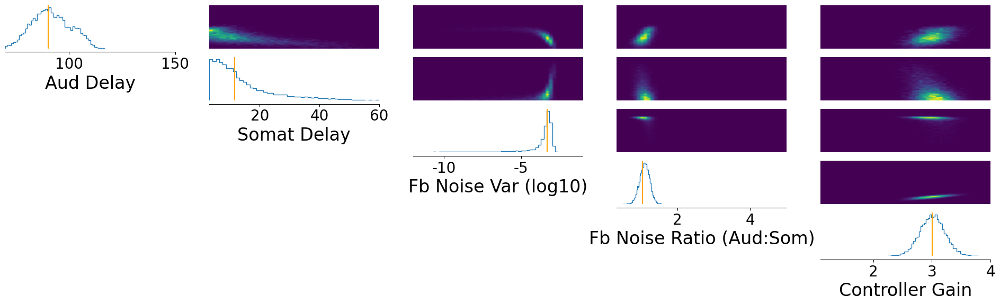

MSE: [0.43479359 2.4534642 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.3851,  18.9407,  -7.0830,   1.9133,   1.9723])


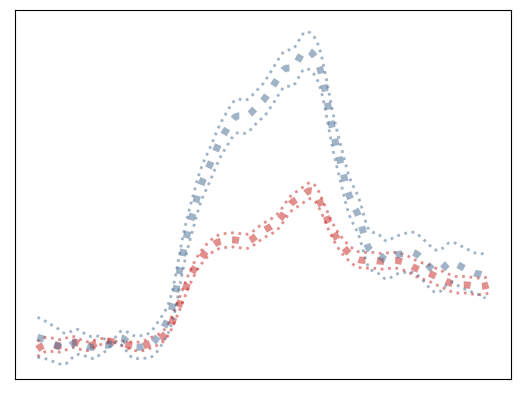

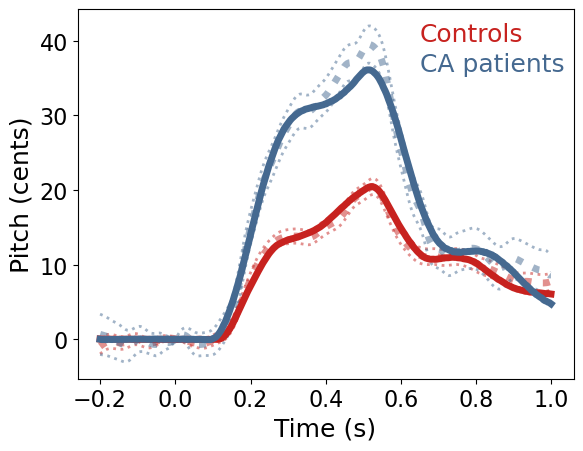

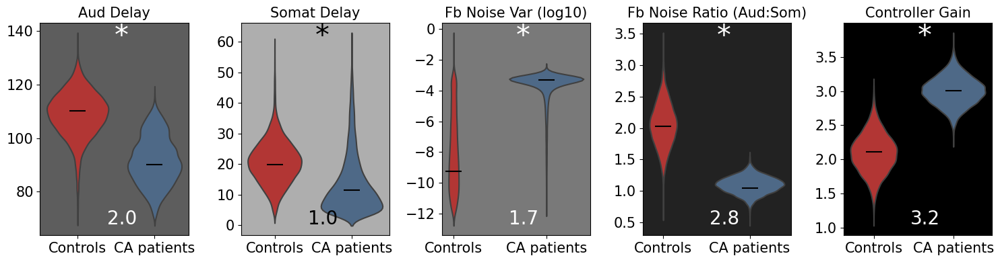

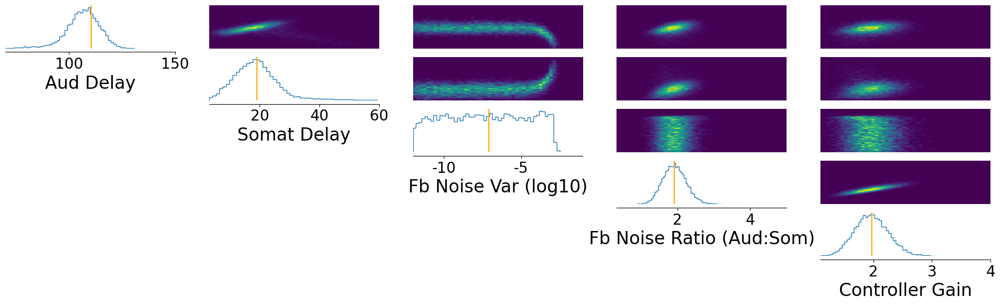

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([82.4747, 29.2631, -3.0508,  0.9505,  2.8754])


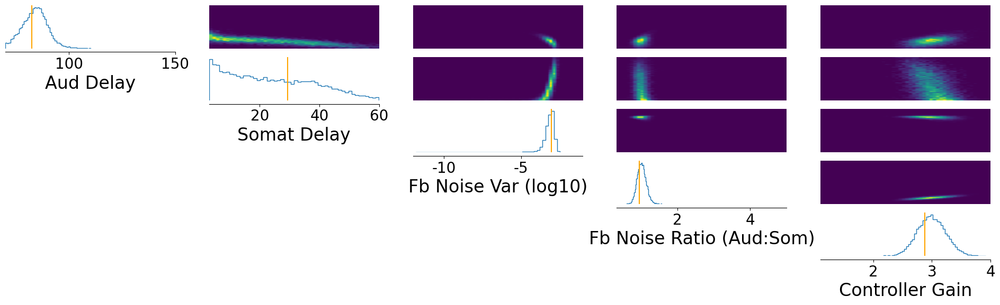

MSE: [0.35314659 2.13900372]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([109.5357,  18.8025,  -9.4262,   1.8212,   1.9053])


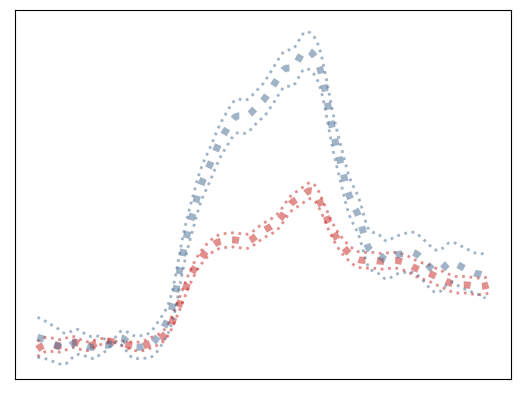

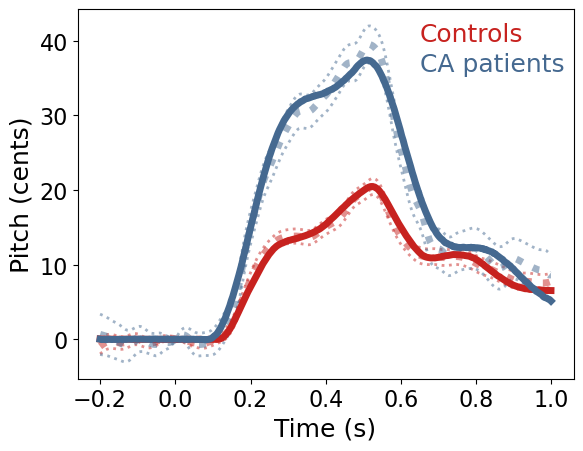

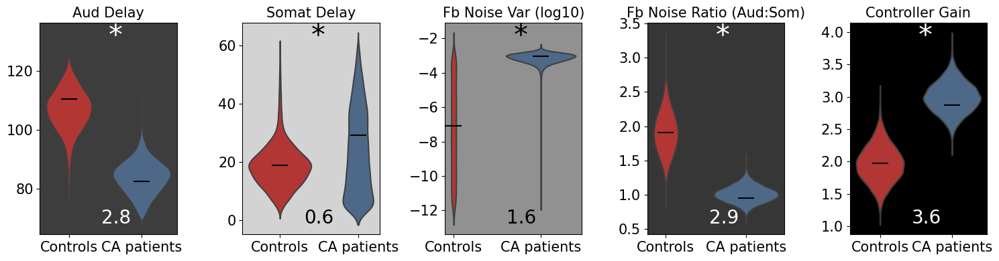

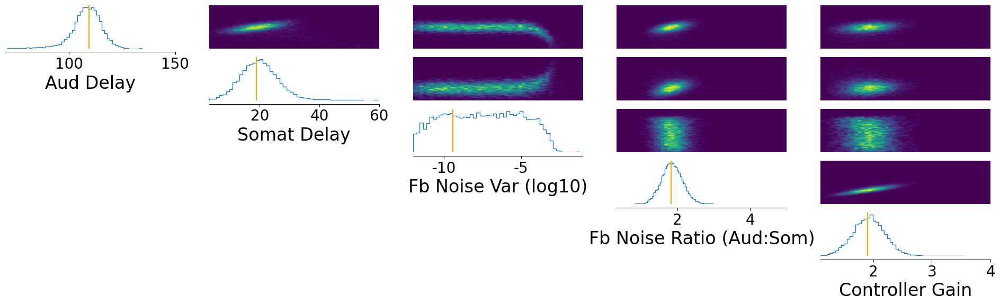

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.2502, 12.1349, -3.2218,  0.9697,  2.9845])


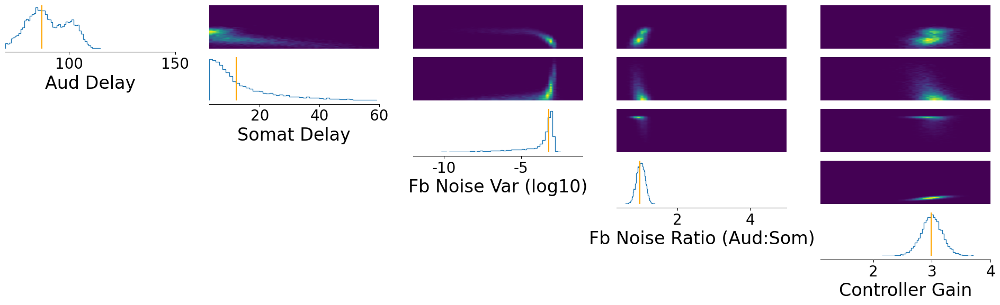

MSE: [0.32924064 2.09691375]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.0182,  22.9097, -10.3851,   1.8737,   1.9354])


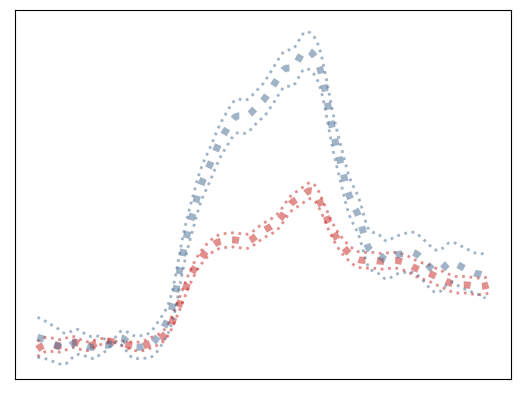

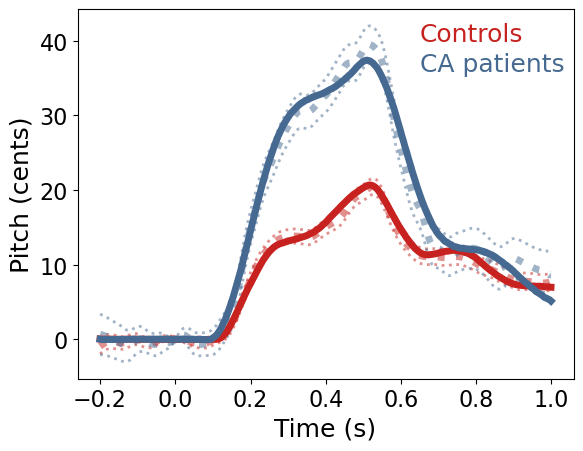

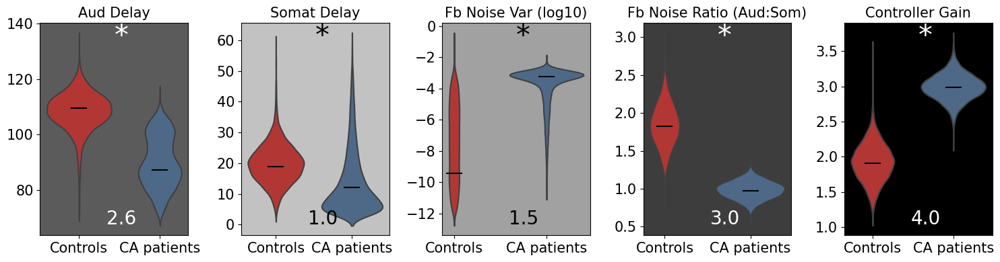

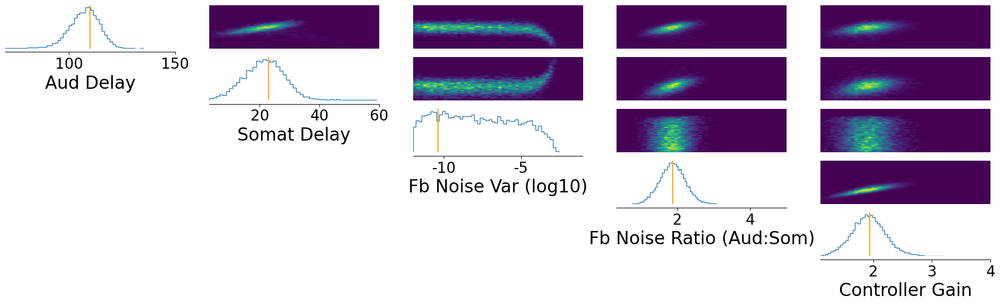

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.1712,  3.4487, -3.5827,  1.0427,  3.0675])


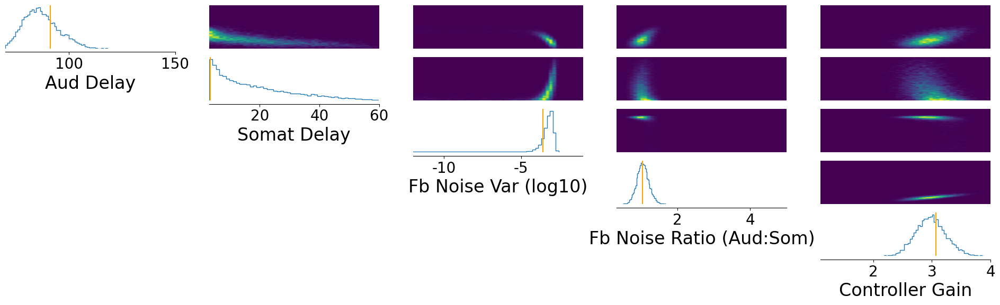

MSE: [0.32321794 2.55459996]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.5544,  21.8889,  -8.2040,   1.9633,   2.0494])


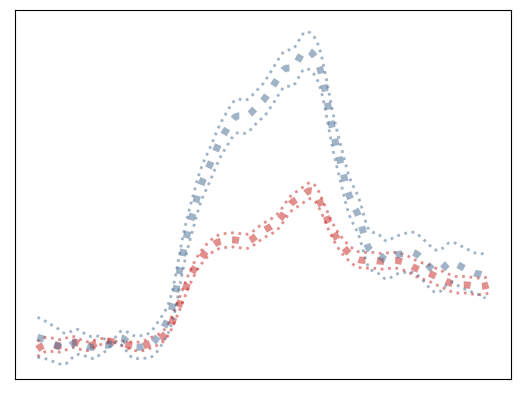

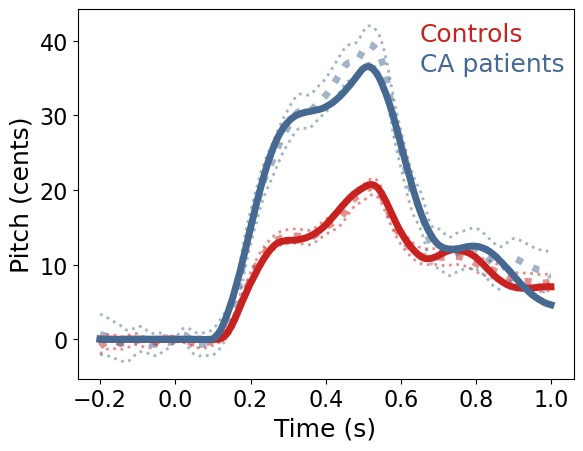

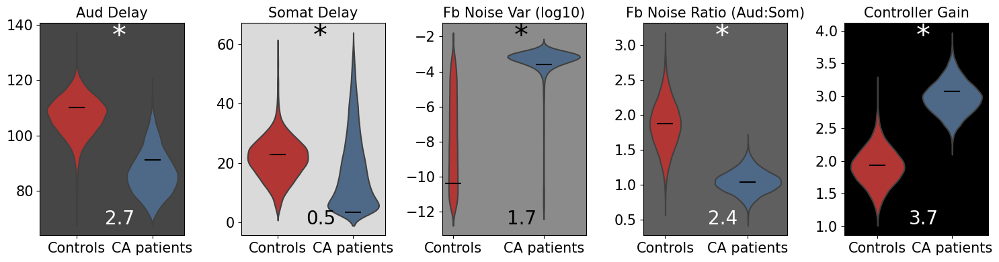

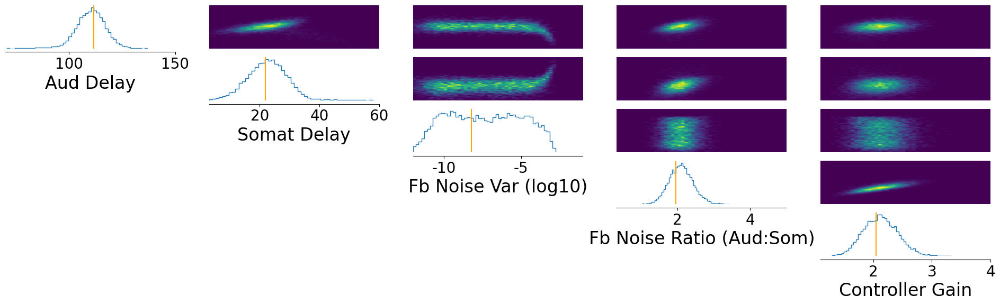

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([88.4062, 15.4899, -3.3055,  1.0397,  3.0457])


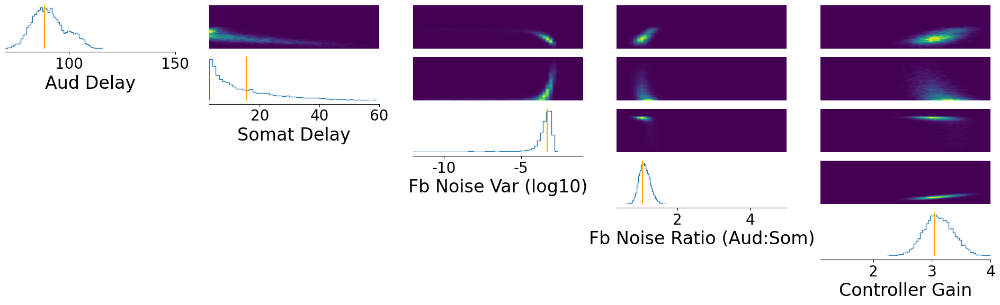

MSE: [0.39518053 2.52748368]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.3217,  19.1038,  -9.8315,   2.0270,   2.1095])


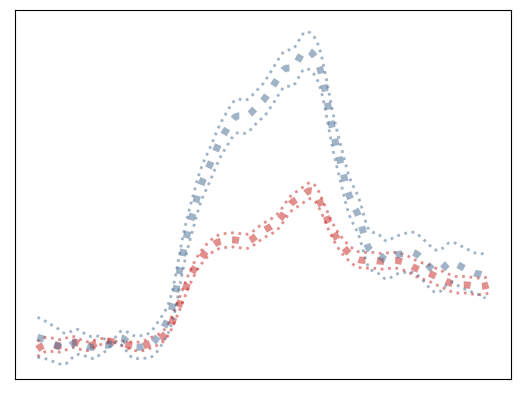

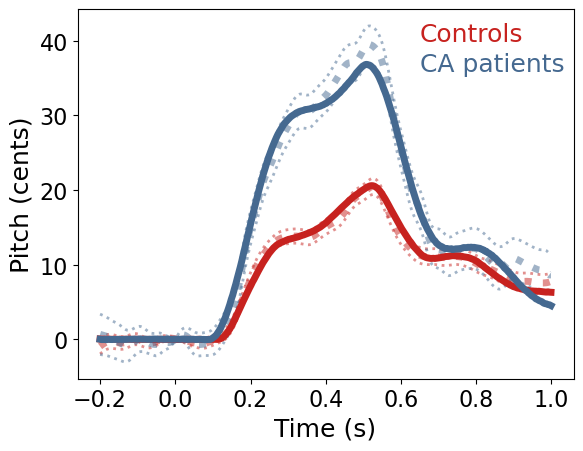

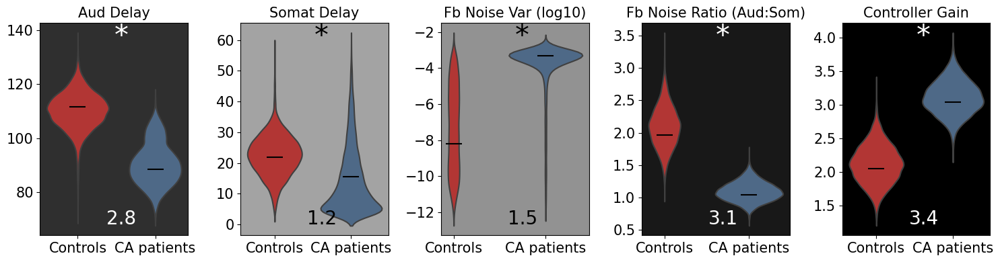

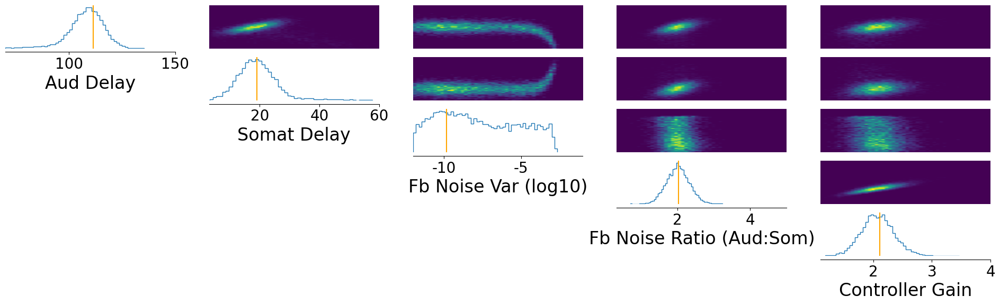

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.9643, 12.2000, -3.1804,  0.8794,  2.8086])


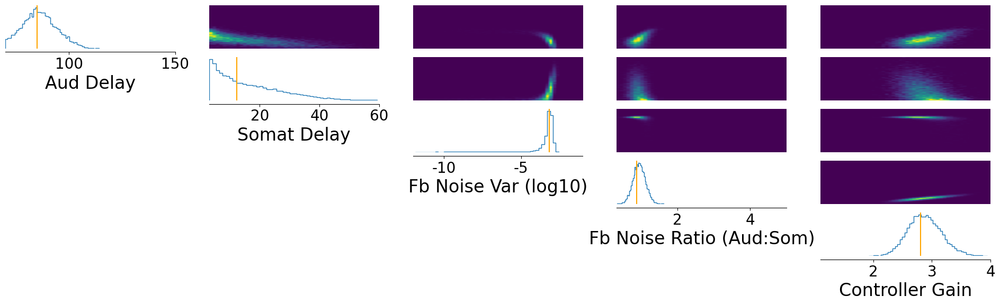

MSE: [0.43603389 2.68353996]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([98.7538, 16.7619, -4.0194,  1.6135,  1.6792])


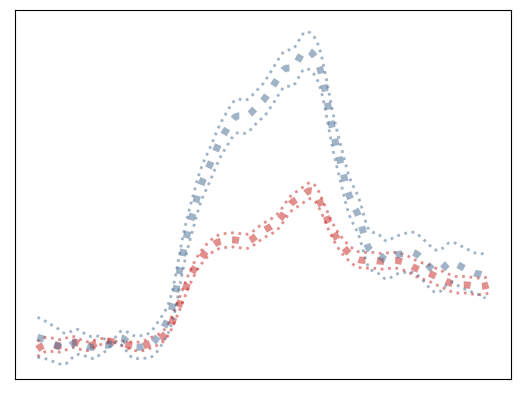

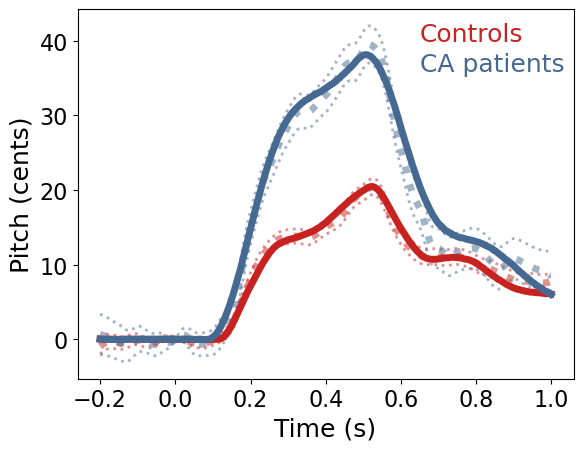

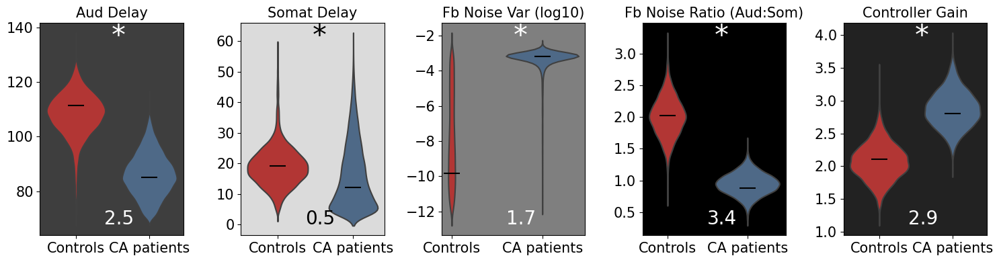

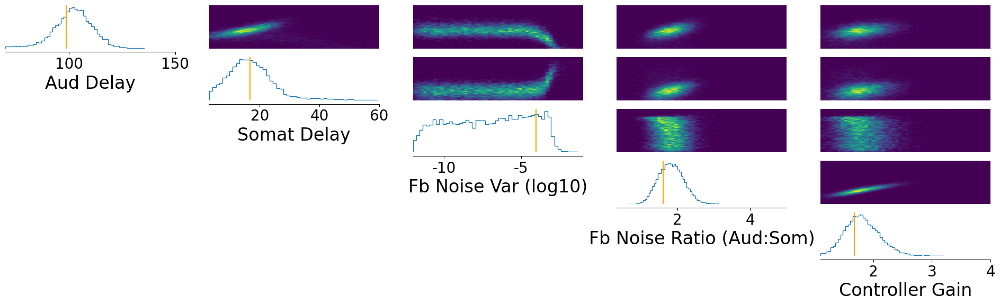

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.7746, 18.7482, -3.0782,  0.9816,  2.9711])


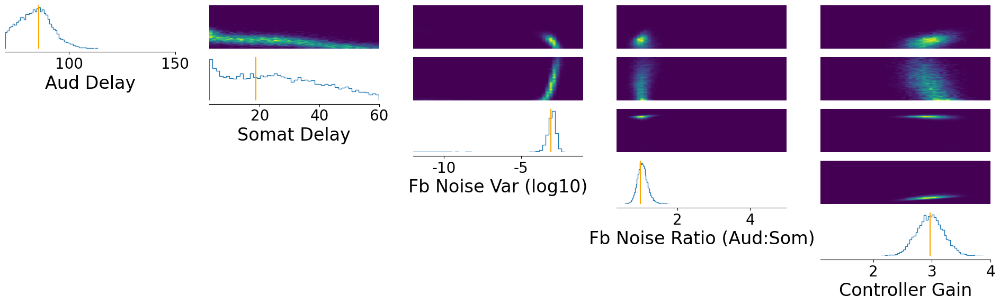

MSE: [0.63792669 2.15198105]


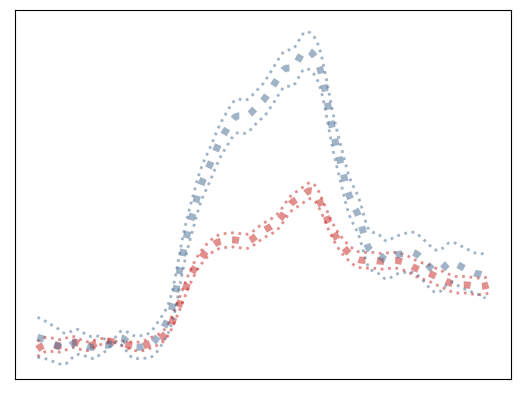

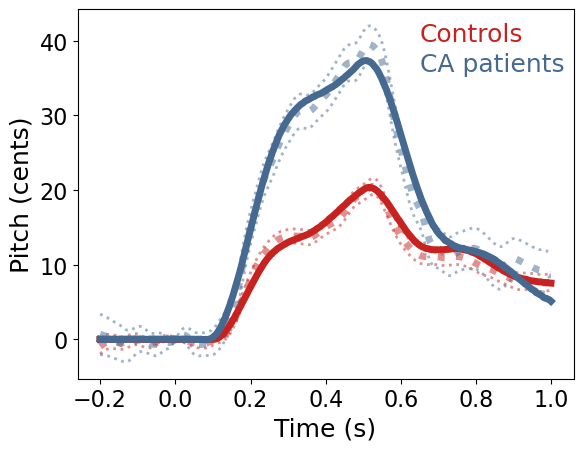

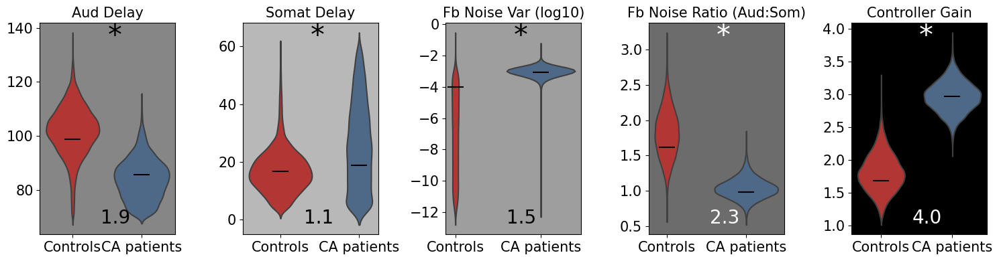

In [20]:
def simulator(parameter_set):
    training_noise_scale = 7
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

data_list,inferred_control_values_all, mse_vals[2,:,:] = run_sbi('training_noise_7',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([93.9360, 30.3509, -3.4939,  1.5259,  1.6925])


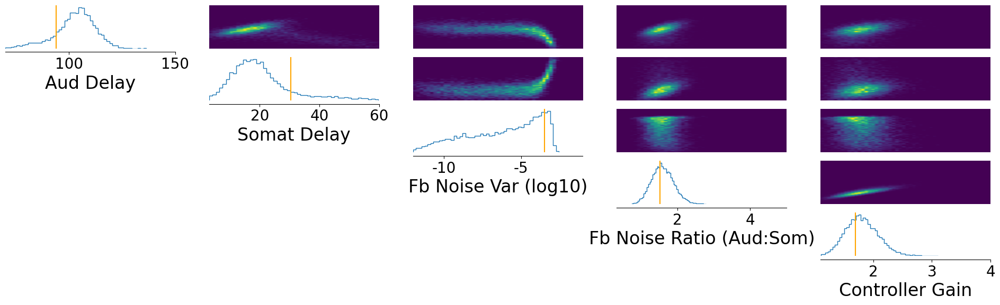

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.2419, 20.5731, -3.2405,  0.8749,  2.8401])


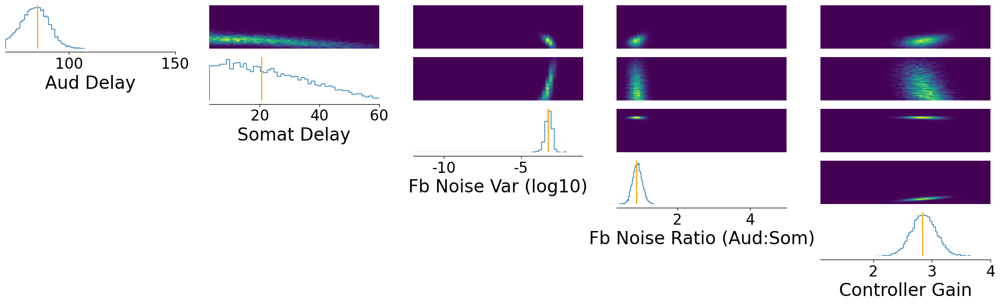

MSE: [1.29893035 2.8661094 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([105.1614,  16.7277,  -7.6262,   1.5685,   1.6867])


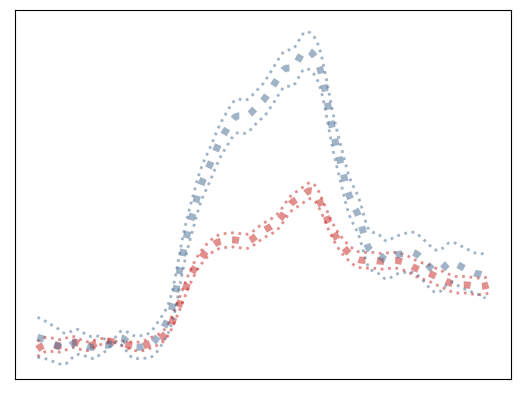

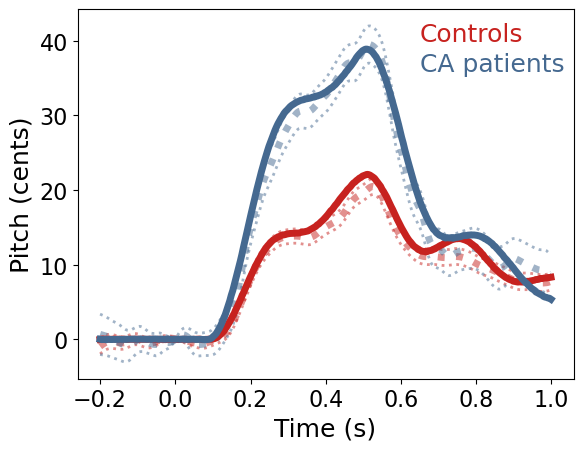

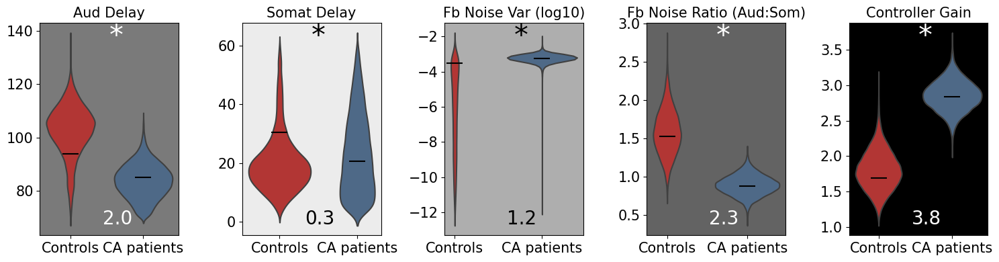

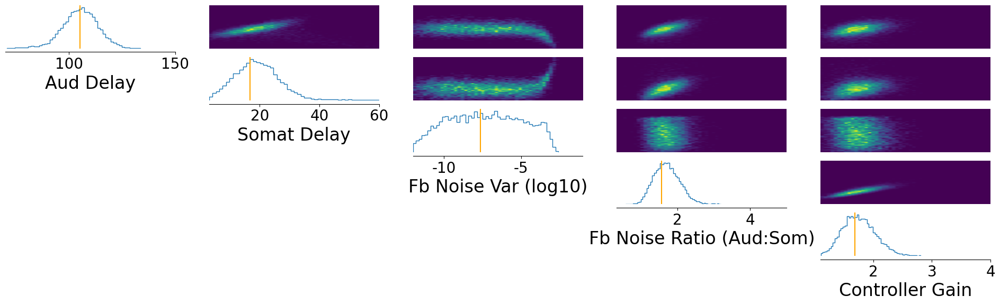

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.5130, 11.5349, -3.3526,  0.9158,  2.9202])


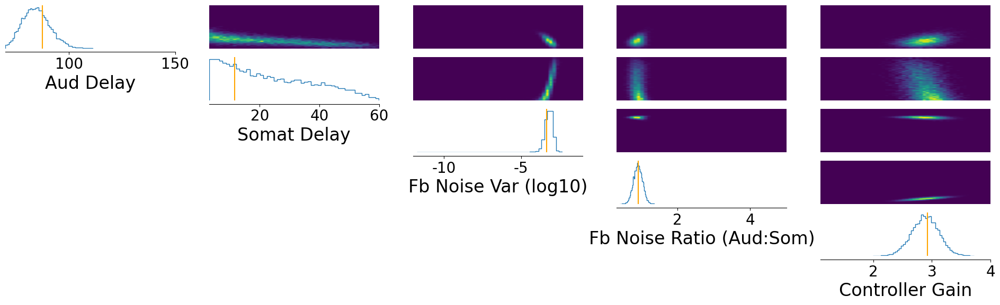

MSE: [0.67000337 2.36835615]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([102.2441,  24.8529,  -4.0779,   1.8245,   1.9022])


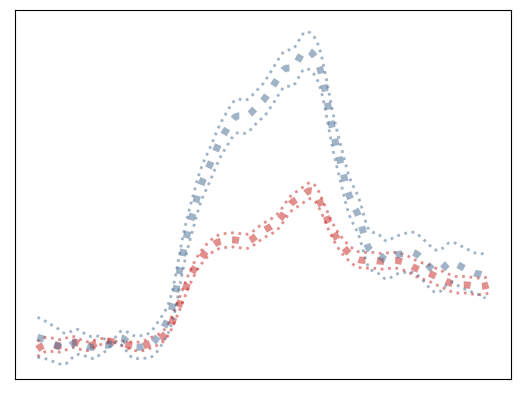

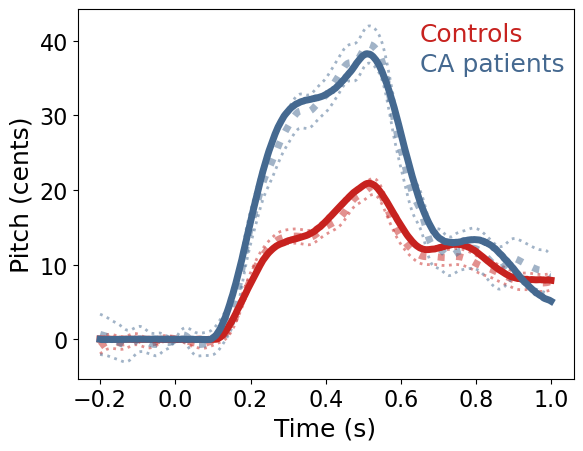

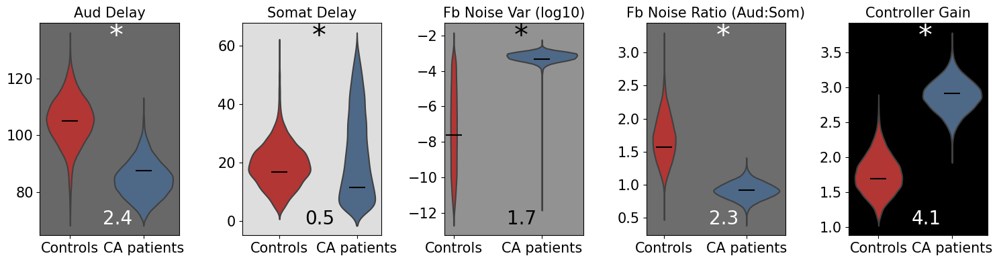

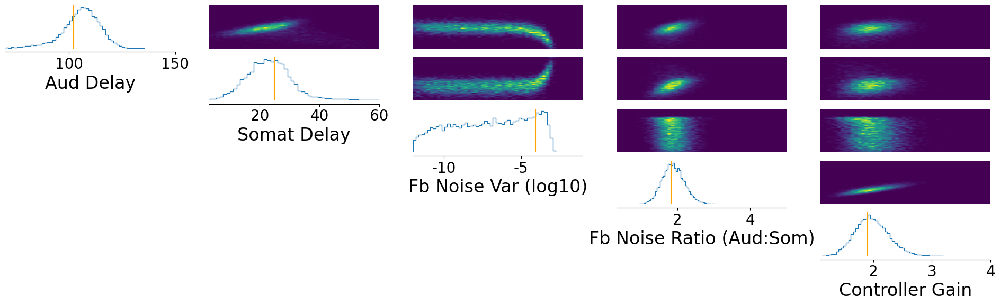

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.6401, 25.7336, -3.2413,  0.9331,  2.9374])


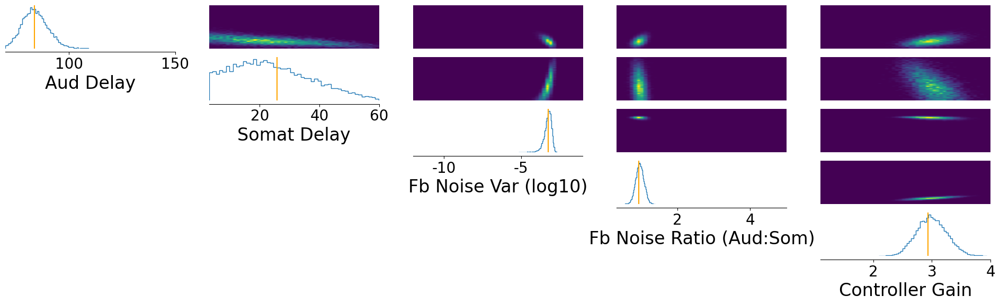

MSE: [0.35873292 3.0948098 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([95.8018, 14.3633, -4.2791,  1.6224,  1.8077])


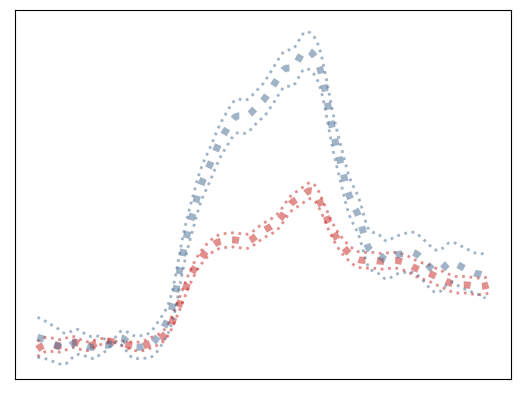

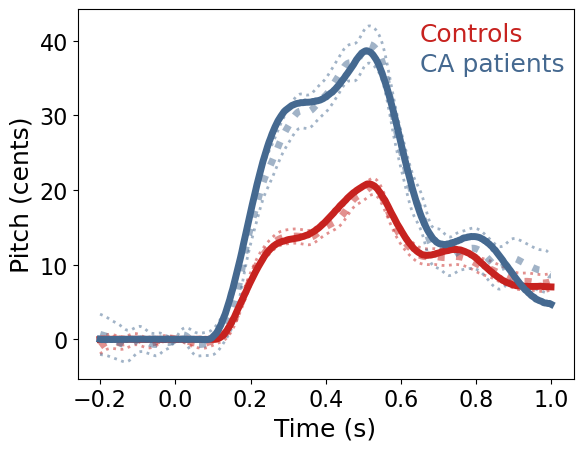

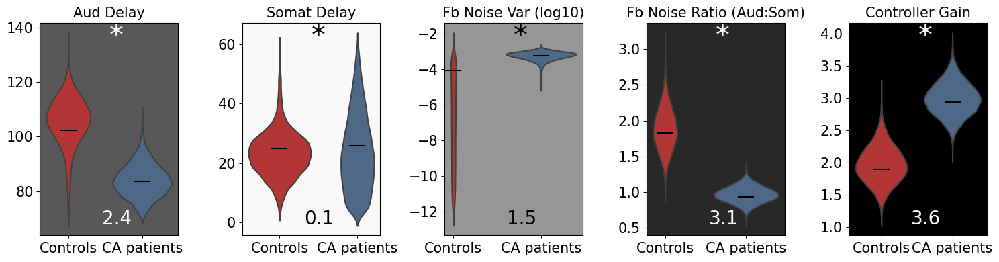

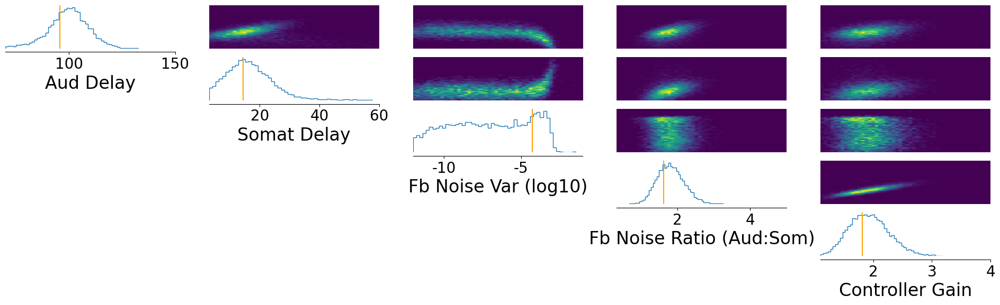

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.1998,  6.5312, -3.2355,  0.9105,  2.9616])


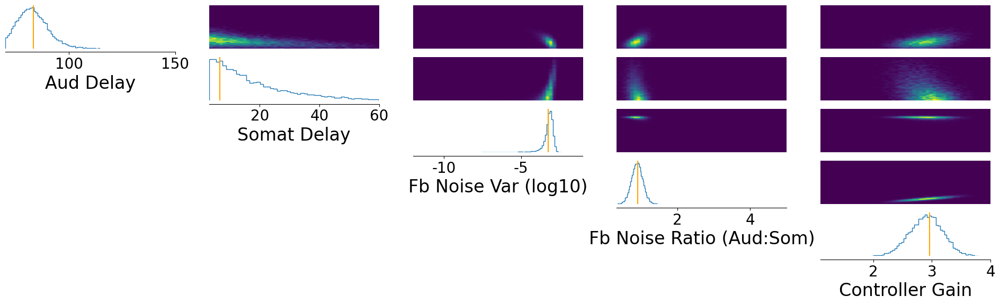

MSE: [0.96577763 2.53669602]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([109.6105,  24.0212, -10.4475,   2.0050,   1.9360])


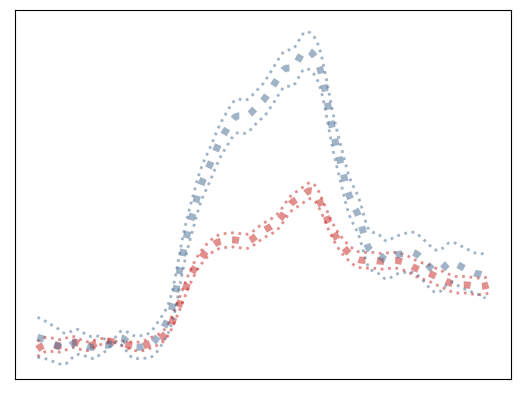

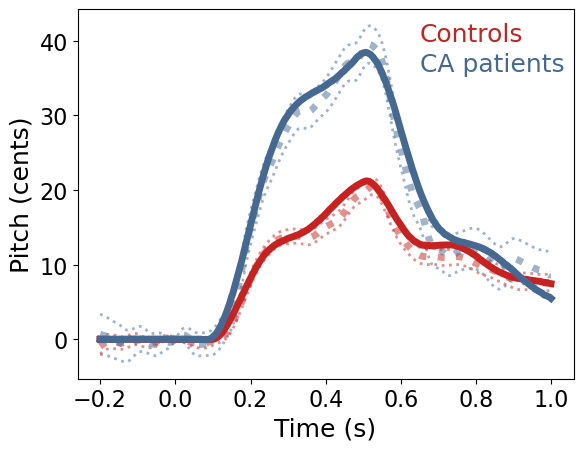

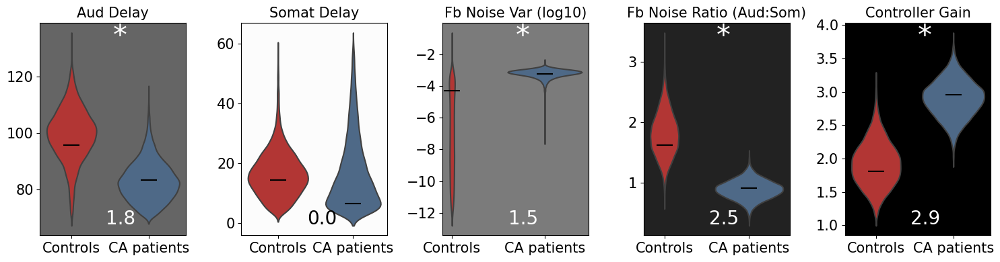

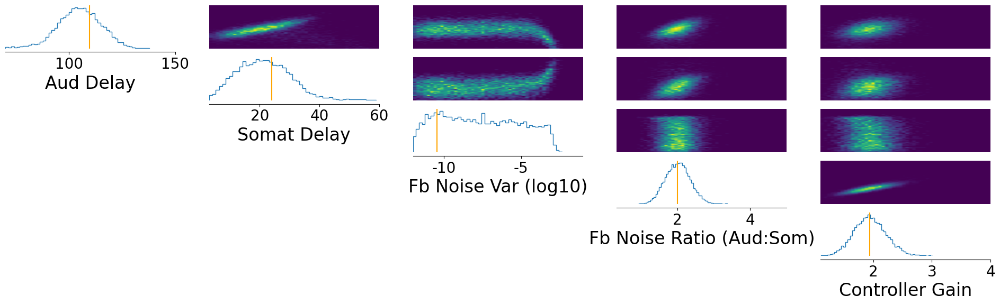

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.5730, 13.3673, -3.1878,  0.9977,  2.8468])


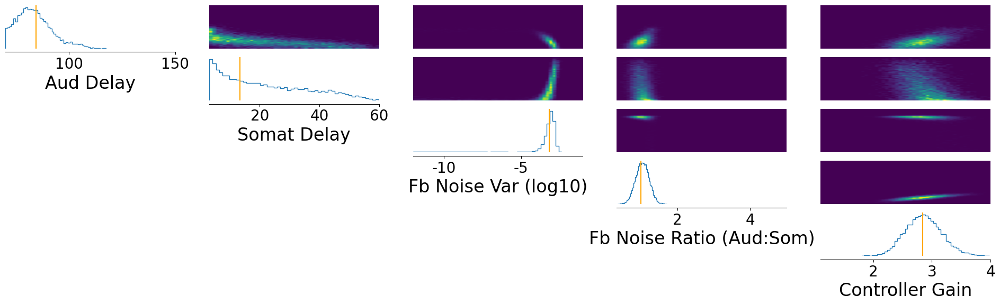

MSE: [0.46631387 2.69563876]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([115.2992,  26.0856,  -9.0596,   2.1176,   2.1354])


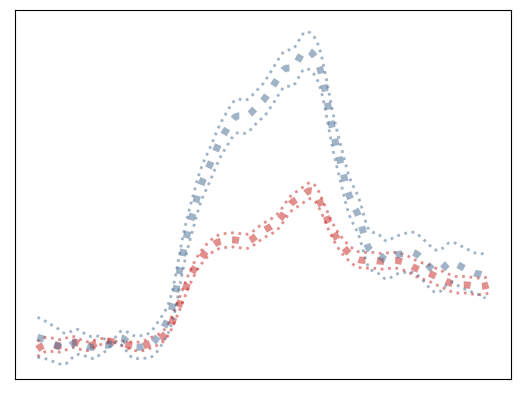

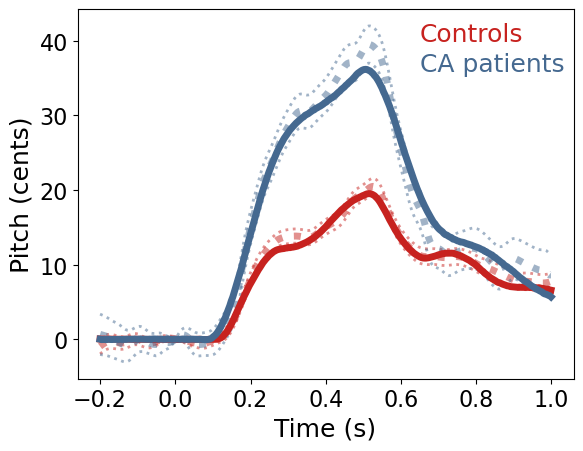

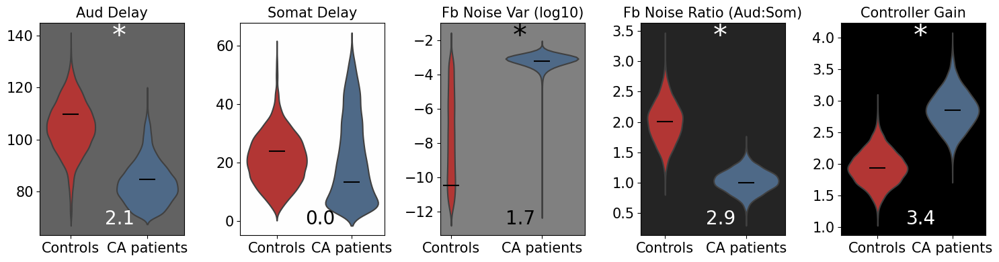

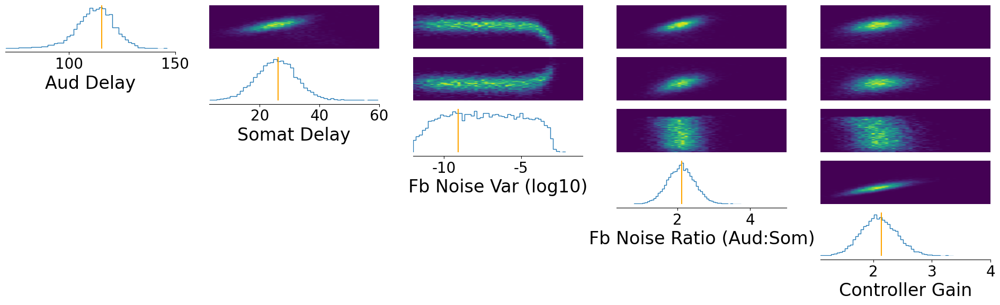

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.1776, 13.1807, -3.3211,  0.9865,  2.8963])


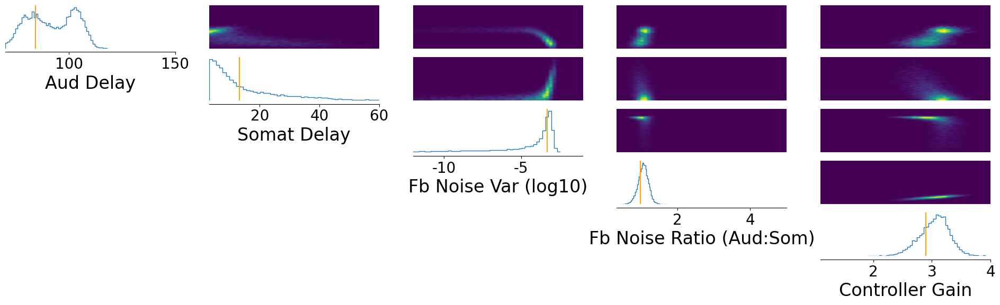

MSE: [0.54253689 2.46433299]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.0298,  20.6547,  -9.8634,   1.9422,   2.1725])


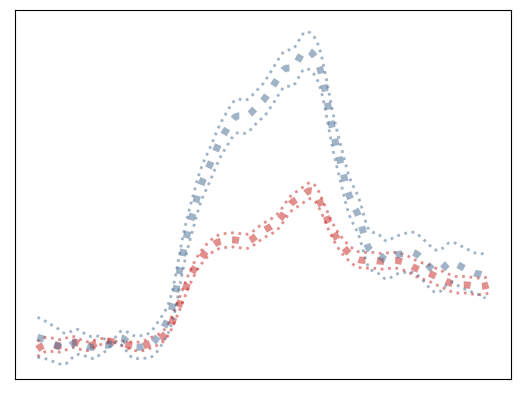

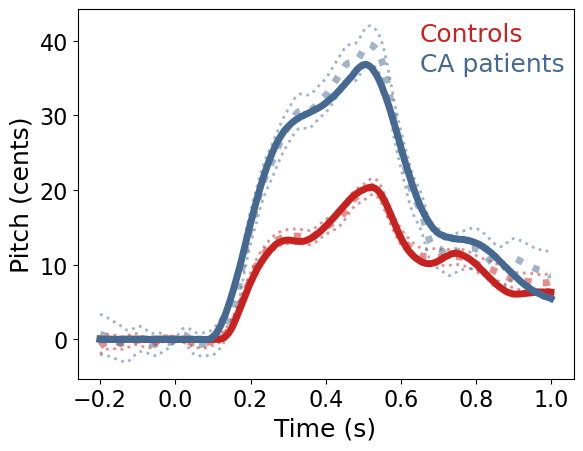

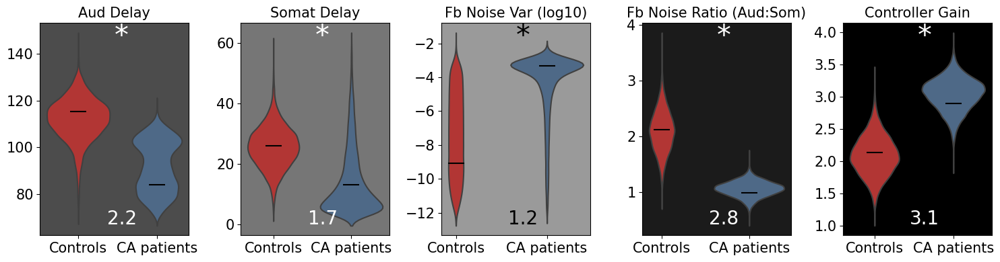

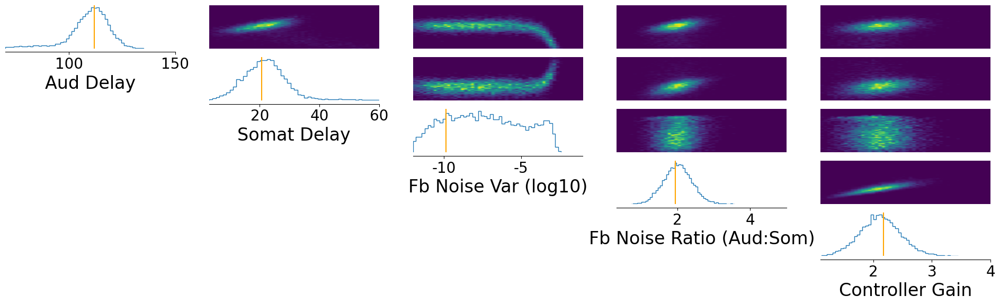

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([103.0482,   3.0264,  -6.8158,   1.2181,   3.3126])


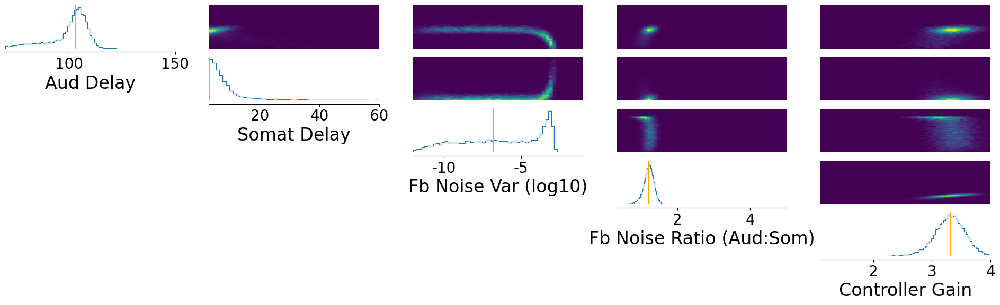

MSE: [0.77257007 8.39395082]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([104.9280,  20.1299,  -4.3602,   1.8186,   1.9745])


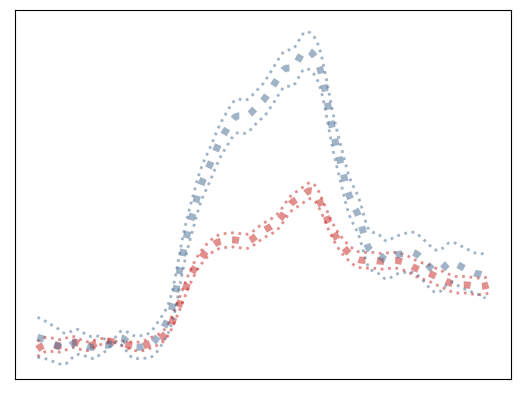

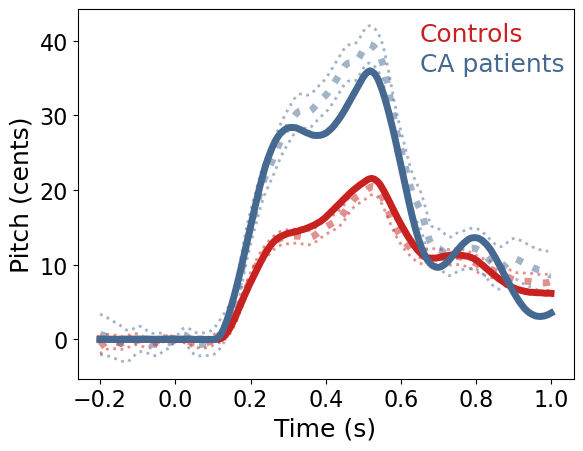

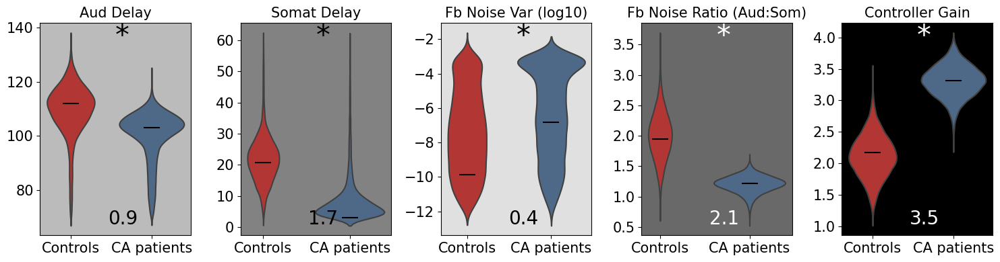

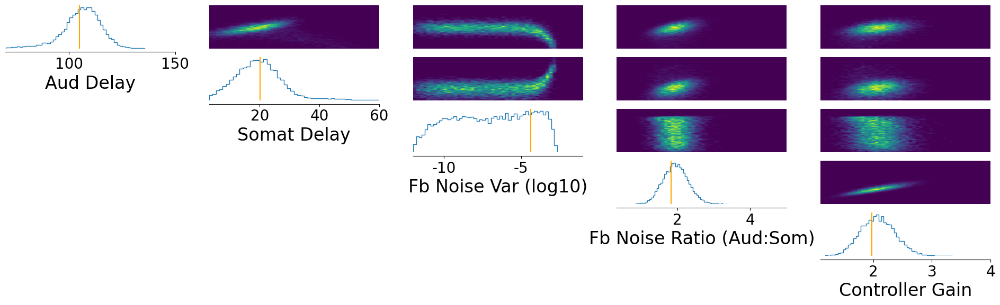

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.6085, 22.1038, -3.1169,  0.9176,  2.8466])


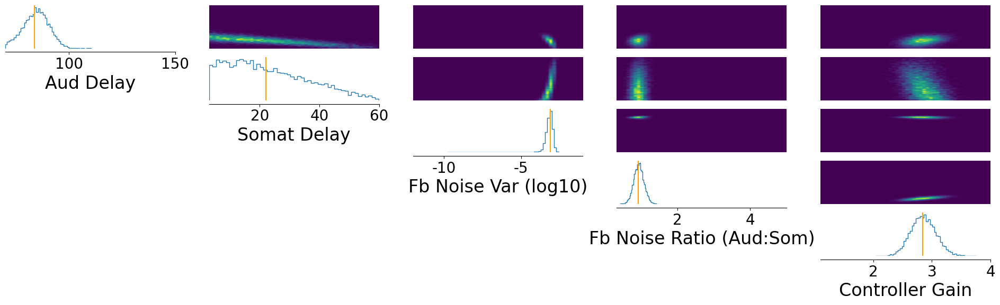

MSE: [0.53847278 2.24148223]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([107.3032,  21.2812,  -9.2893,   1.9329,   1.9677])


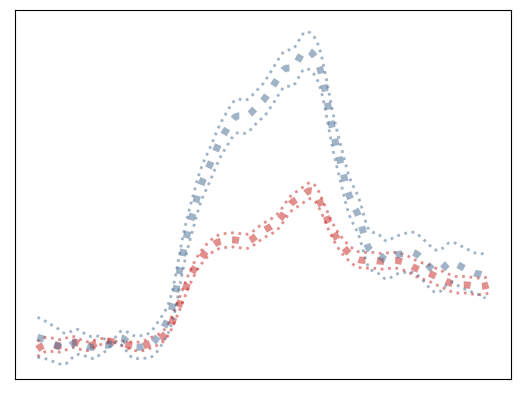

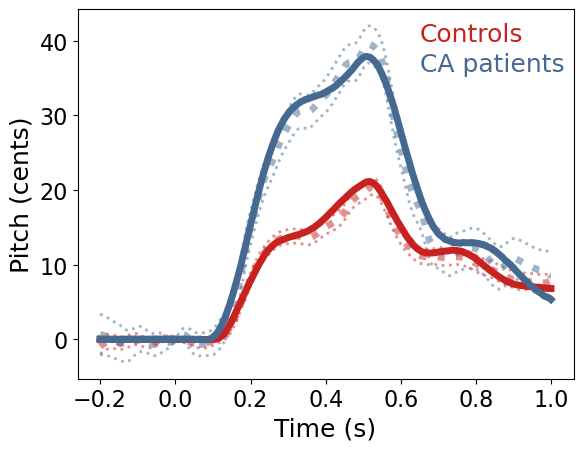

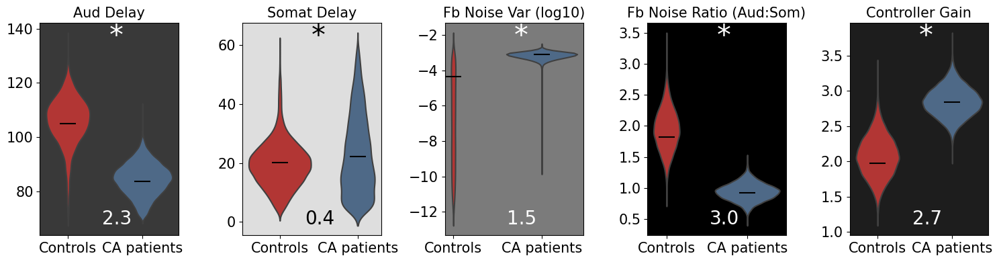

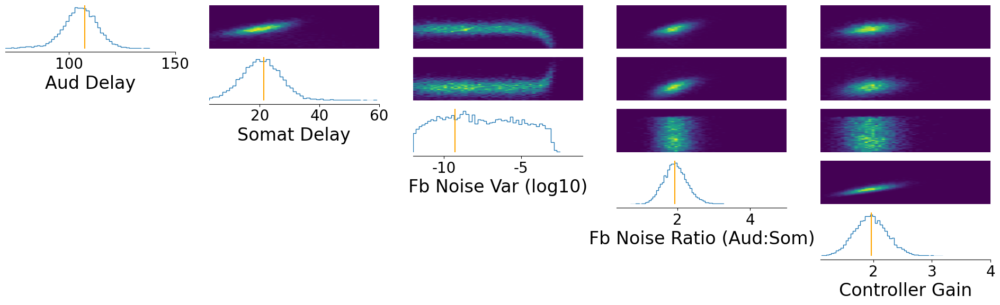

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.0571, 17.5005, -3.2397,  0.8974,  2.9131])


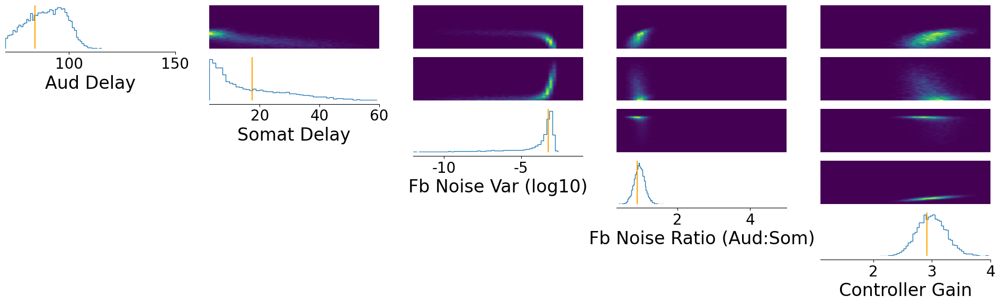

MSE: [0.30867192 2.60580272]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([103.2265,  16.1232,  -6.4316,   2.0186,   2.1480])


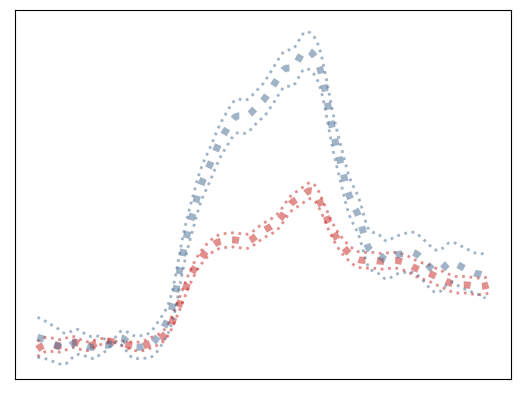

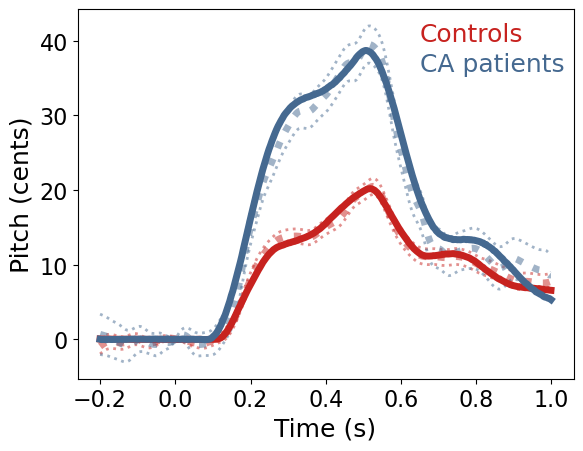

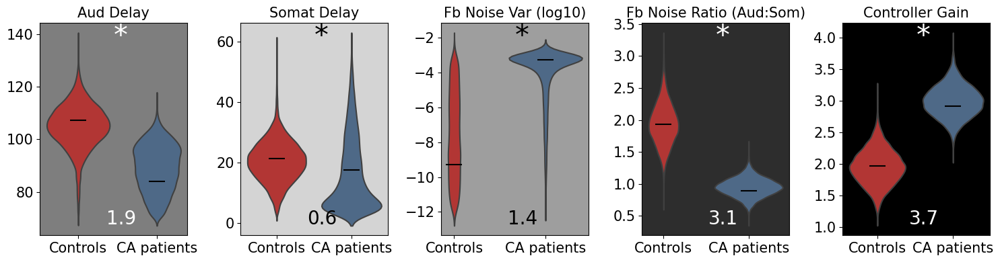

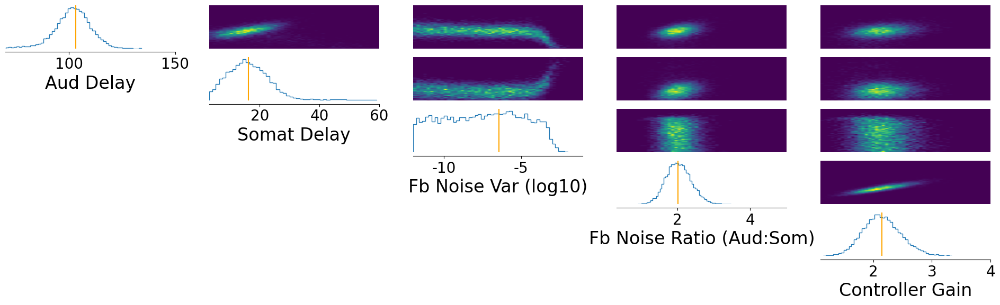

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.4347, 19.6845, -3.2110,  0.9170,  2.8953])


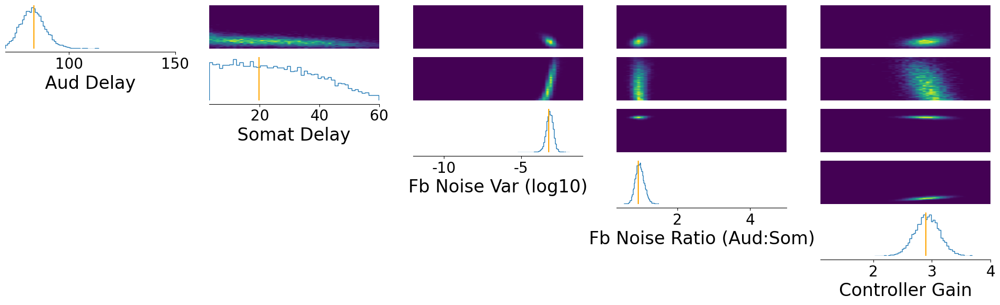

MSE: [0.52774455 2.41077126]


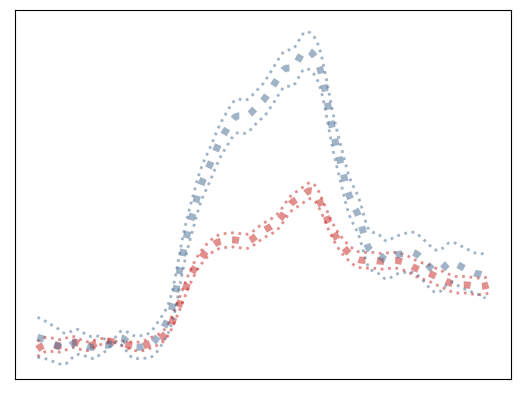

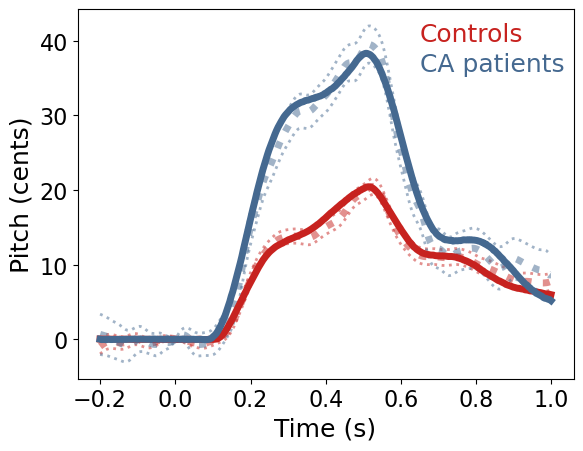

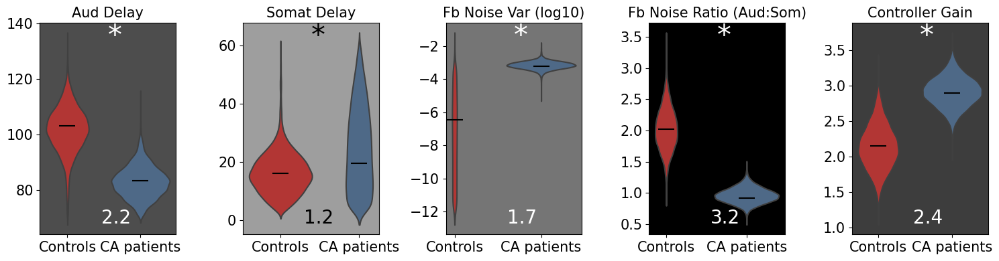

In [21]:
def simulator(parameter_set):
    training_noise_scale = 9
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

data_list,inferred_control_values_all, mse_vals[3,:,:] = run_sbi('training_noise_9',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

<Figure size 200x300 with 0 Axes>

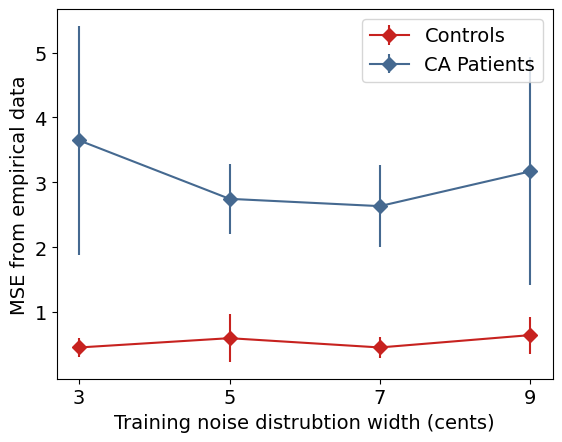

In [23]:
x = np.array([3,5,7,9])
bar_data = np.mean(mse_vals,axis=2)
bar_df = pd.DataFrame(bar_data,columns=['Controls','CA Patients'])
se_data = np.std(mse_vals,axis=2)
se_df = pd.DataFrame(se_data,columns = ['Controls','CA Patients'])
plt.figure(figsize=(2,3))
bar_df.plot(kind='line',yerr=se_df,rot=0,marker='D',markersize=7,color=[data_list[0].get('color'),data_list[1].get('color')])
plt.ylabel('MSE from empirical data',fontsize=14)
plt.xticks(ticks=range(len(x)),labels=x,fontsize=14)
plt.yticks(ticks=range(1,6),fontsize=14)
plt.xlabel('Training noise distrubtion width (cents)',fontsize=14)
plt.legend(fontsize=14)
plt.show()